# Network metrics in SC and FC

In [1]:
%cd work/notebooks

# Import modules and R
import numpy as np, pandas as pd
%load_ext rpy2.ipython
%load_ext autoreload
%autoreload 2

# Import local code
import sys
sys.path.append('/home/jovyan/work/code')
from gradientVersion import *
from processing_helpers import *
from analysis_helpers import *
from mri_maps import *
%R source("../code/Rplots.R");
%R source("../code/brainPlots.R");

/home/jovyan/work/notebooks


System has not been booted with systemd as init system (PID 1). Can't operate.
Failed to connect to bus: Host is down


In [2]:
dme_3d_ds5 = gradientVersion().fit('hcp_3donors_ds5')
hcp_scores = dme_3d_ds5.clean_scores()
null_scores = np.load("../outputs/permutations/hcp_3d_ds5_spin_5000_v2.npy")

# dme_ds8 = gradientVersion().fit('hcp_ds8')
# hcp_scores = dme_ds8.clean_scores()
# null_scores = np.load("../outputs/permutations/hcp_ds8_spin_5000_v2.npy")
# dme_ds8 = gradientVersion().fit('hcp_ds8')
# dme_ds5 = gradientVersion().fit('hcp_ds5')

New gradients version: method=dm, kernel=normalized_angle, sparsity=0, data=hcp_3donors_ds5


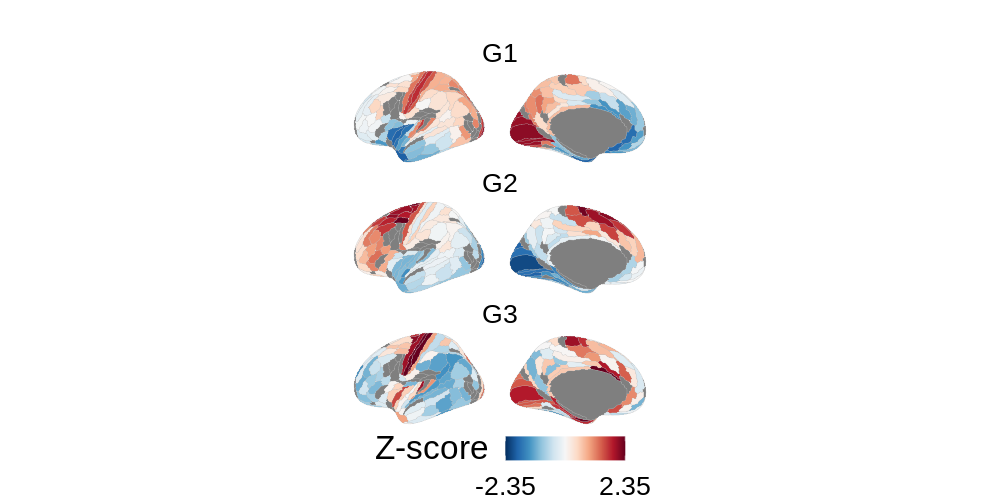

In [6]:
%%R -i hcp_scores -w 10 -h 5 -u in -r 100
plot_hcp(hcp_scores, facet='w') + theme(text=element_text(size=24))

## Distances

In [32]:
# xyz_old = fetch_hcp()['info'].set_index('id').loc[:, ['x-cog','y-cog','z-cog']].set_axis(['x','y','z'],axis=1)
xyz = pd.read_csv("../data/parcellations/centroids_HCP.csv", header=None, names=['x','y','z'])
from sklearn.metrics.pairwise import euclidean_distances
hcp_euclidean = euclidean_distances(xyz,xyz)
# hcp_euclidean_old = euclidean_distances(xyz_old,xyz_old)
# hcp_geodesic = np.loadtxt("../data/parcellations/LeftParcelGeodesicDistmat.txt")

In [34]:
import mat73
hcp_tract_lengths = mat73.loadmat("../data/averageConnectivity_tractLengths.mat")['tractLengths']
# pearsonr(hcp_euclidean.flatten(), hcp_tract_lengths.flatten())

In [37]:
from scipy.stats import pearsonr
# pearsonr(hcp_euclidean.flatten(), hcp_euclidean_old.flatten())

In [38]:
from scipy.stats import pearsonr
pearsonr(hcp_euclidean[:180,:][:,:180].flatten(), hcp_geodesic.flatten())

NameError: name 'hcp_geodesic' is not defined

In [2304]:
distance_maps = (pd.DataFrame({
    'mean euclidean distance':hcp_euclidean[:180,:][:,:180].mean(0),
    'mean geodesic distance':hcp_geodesic.mean(0),
    'mean tract length': hcp_tract_lengths[:180,:][:,:180].mean(0)
}, index=range(1,181))
.assign(label=get_labels_hcp()[:180])
.set_index('label')
.apply(lambda x: (x-np.mean(x))/np.std(x))
)

                        mean euclidean distance mean geodesic distance
mean euclidean distance               1.0000000              0.8137803
mean geodesic distance                0.8137803              1.0000000
mean tract length                     0.5822820              0.7555241
                        mean tract length
mean euclidean distance         0.5822820
mean geodesic distance          0.7555241
mean tract length               1.0000000


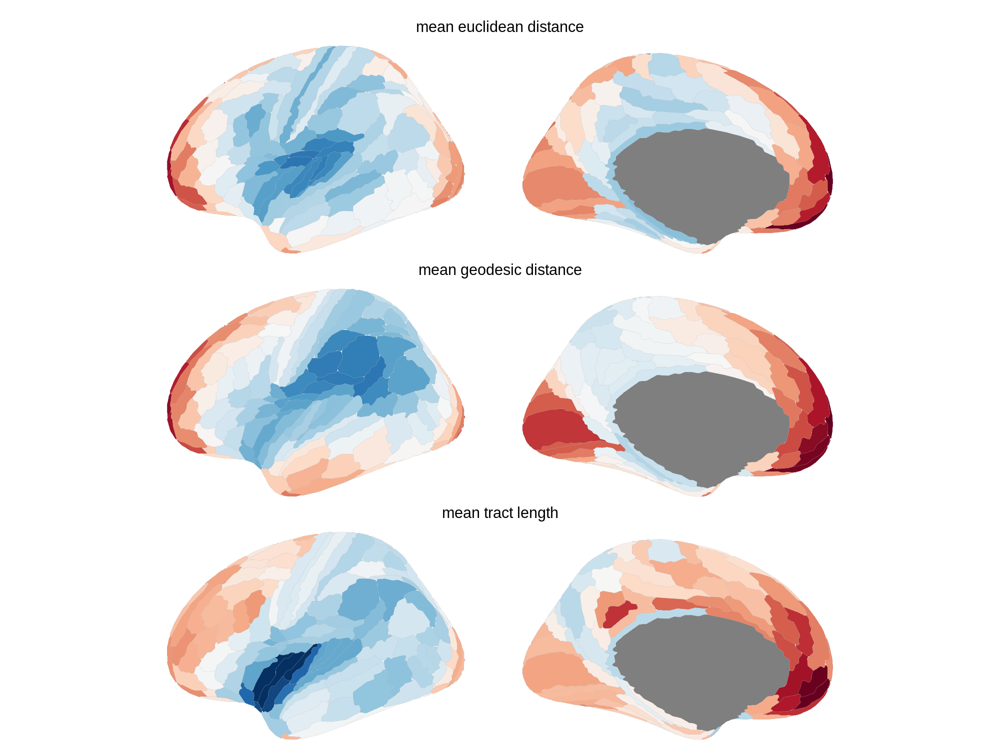

In [2307]:
%%R -i distance_maps -w 20 -h 15 -u in -r 100
print(distance_maps %>% cor(use='p'))
plot_maps(distance_maps, ncol=1) + theme(legend.position='none')

## Compare different datasets

In [39]:
networks = {
    # 'msn': pd.read_csv("../data/networks/MeanMSN.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values/2+.5,
    'MIND(ABCD)_CT_MC_SA_SD_Vol': pd.read_csv("../data/networks/MeanMIND.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values,
    'MIND(HCP)_CT_MC_SA_SD_Vol': pd.read_csv("../data/networks/MeanMIND.HCP.CT_MC_SA_SD_Vol.HCP_data.csv", index_col=0).values,
    # 'mind_new_features': pd.read_csv("../data/networks/MeanMIND.HCP.CT_MC_MD_ICVF.not_normalized.csv", index_col=0).values,
    # # 'dti_demirtas': nib.load("../data/networks/average_sc.pconn.nii").get_fdata(),
    # 'dti_arnatkeviciute': pd.read_csv("../data/networks/MeanDTI_arnatkeceviute.csv", index_col=0).values,
    # # 'dti_enigma': pd.read_csv("../data/networks/MeanDTI_enigma_toolbox.csv", index_col=0).values,
    # # 'dti_prob_trac': pd.read_csv("../data/networks/MeanDTI_prob_trac.csv", index_col=0).values,
    # 'dti_rosen': pd.read_csv("../data/networks/averageConnectivity_Fpt.csv", header=None).values,
    # 'fmri_demirtas': nib.load("../data/networks/average_fc.pconn.nii").get_fdata(),

    'MIND(ABCD)_CT': pd.read_csv("../data/networks/MeanMIND.HCP.CT.csv", index_col=None, header=None, delimiter=' ').values,
    'MIND(ABCD)_MC': pd.read_csv("../data/networks/MeanMIND.HCP.MC.csv", index_col=None, header=None, delimiter=' ').values,

    'FC(HCP)': pd.read_csv("../data/networks/paquola_FCmatrix.csv", header=None).values,
    # 'WD': pd.read_csv("../data/networks/paquola_WDmatrix.csv", header=None).values,
    # 'BB': pd.read_csv("../data/networks/paquola_BBmatrix.csv", header=None).values,
    'MPC(HCP)': pd.read_csv("../data/networks/paquola_MPCmatrix.csv", header=None).values,
    # 'GD': pd.read_csv("../data/networks/paquola_GDmatrix.csv", header=None).values,
    # 'TS': pd.read_csv("../data/networks/paquola_TSmatrix.csv", header=None).values,
}

# for net in networks.values():
#     np.fill_diagonal(net, np.nan)

# networks['BB'] = networks['BB'] - np.nanmin(networks['BB'])

for net in networks.values():
    np.fill_diagonal(net, 0)

In [40]:
pd.concat({name:pd.Series(net.flatten()) for name,net in networks.items()}, axis=1).describe()

,MIND(ABCD)_CT_MC_SA_SD_Vol,MIND(HCP)_CT_MC_SA_SD_Vol,MIND(ABCD)_CT,MIND(ABCD)_MC,FC(HCP),MPC(HCP)
count,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000
mean,0.119359,0.119359,0.497318,0.526537,0.191473,7857.264797
std,0.037570,0.037570,0.162238,0.148905,0.129095,4536.409469
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.091590,0.091590,0.372270,0.424804,0.094076,3929.250000
50%,0.116481,0.116481,0.521450,0.544949,0.166263,7857.500000
75%,0.144956,0.144956,0.631941,0.639955,0.267534,11785.750000
max,0.393482,0.393482,0.918366,0.929032,0.901380,15714.000000


In [41]:
# Pearson
df_pearson = pd.concat({name:pd.Series(net.flatten()) for name,net in networks.items()}, axis=1).corr()
# Spearman
df_spearman = pd.concat({name:pd.Series(net.flatten()) for name,net in networks.items()}, axis=1).rank().corr()
df_pearson

,MIND(ABCD)_CT_MC_SA_SD_Vol,MIND(HCP)_CT_MC_SA_SD_Vol,MIND(ABCD)_CT,MIND(ABCD)_MC,FC(HCP),MPC(HCP)
MIND(ABCD)_CT_MC_SA_SD_Vol,1.000000,1.000000,0.504155,0.689842,0.171954,0.185651
MIND(HCP)_CT_MC_SA_SD_Vol,1.000000,1.000000,0.504155,0.689842,0.171954,0.185651
MIND(ABCD)_CT,0.504155,0.504155,1.000000,0.280782,0.134193,0.214361
MIND(ABCD)_MC,0.689842,0.689842,0.280782,1.000000,0.089911,0.114725
FC(HCP),0.171954,0.171954,0.134193,0.089911,1.000000,0.174194
MPC(HCP),0.185651,0.185651,0.214361,0.114725,0.174194,1.000000


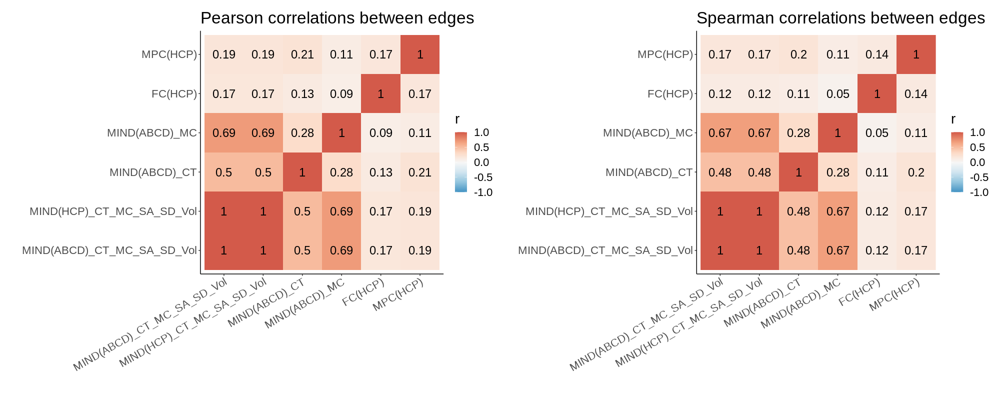

In [42]:
%%R -i df_pearson -i df_spearman -w 20 -h 8 -u in -r 100
plot_corrmat <- function(df) {
    df %>%
    rownames_to_column('x') %>% 
    pivot_longer(-x, names_to='y', values_to='r') %>% 
    mutate(
        x = factor(x, ordered=T, levels=unique(.$x)),
        y = factor(y, ordered=T, levels=unique(.$y))
    ) %>% 
    ggplot(aes(x,y)) + geom_raster(aes(fill=r)) + 
    geom_text(aes(label=round(r,2)), size=6) + 
    scale_fill_gradientn(colors=rev(brewer.rdbu(100)[20:80]), limits=c(-1,1)) +
    xlab('') + ylab('') +
    theme_classic() + 
    theme(aspect.ratio=1,
        text=element_text(size=20),
        axis.text.x=element_text(angle=30, hjust=1),
        legend.position='right'
    )
}

plot_corrmat(df_pearson) + ggtitle('Pearson correlations between edges') |
plot_corrmat(df_spearman) + ggtitle('Spearman correlations between edges')

### Compute modules?

Different for each network

In [173]:
import bct
gamma = 1.06

for net in networks.values():
    np.fill_diagonal(net, 0)

modules_louvain = {
    name:bct.community_louvain(net, gamma=gamma, seed=1)[0] 
    # name:bct.modularity_louvain_und(net, gamma=gamma)[0] 
    for name, net in networks.items()
}

### Use Yeo modules?

Same for each network

In [176]:
yeo = np.loadtxt("../data/HCP_Yeo_asymmetric.txt")
yeo_names = ['Visual','Somatomotor','Dorsal Attention','Ventral Attention','Limbic','Frontoparietal','Default']

df_modules = (get_labels_hcp().to_frame()
 .assign(module = yeo)
 .assign(module_name = lambda x: x['module'].map({i+1:name for i,name in enumerate(yeo_names)}))
 .sort_values('module')
)

modules_yeo = {name:yeo for name,net in networks.items()}
# modules_yeo[''].shape

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:65: UserWarning: Error while trying to convert the column "module_name". Fall back to string conversion. The error is: Series can only be of one type, or None (and here we have <class 'float'> and <class 'str'>). If happening with a pandas DataFrame the method infer_objects() will normalize data types before conversion.
  warnings.warn('Error while trying to convert '



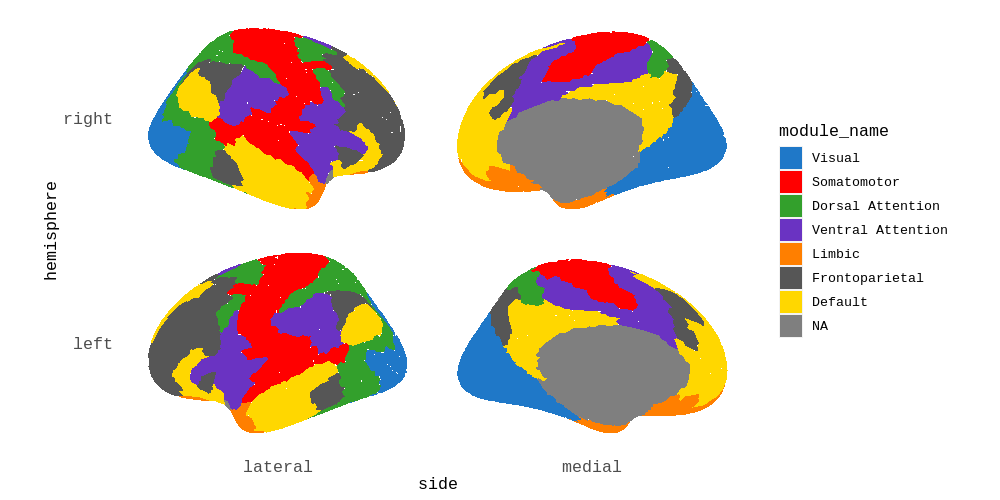

In [175]:
%%R -i df_modules -w 10 -h 5 -u in -r 100
library(pals)
df_modules %>% rename(region=label) %>% 
mutate(module_name = factor(module_name, ordered=T, levels=unique(.$module_name))) %>% 
ggseg(atlas=glasser, position='stack', mapping=aes(fill=module_name)) + 
scale_fill_manual(values=cols25(12))

### Use Ji modules

In [91]:
ji_networks = np.loadtxt("../data/parcellations/cortex_parcel_network_assignments.txt")
ji_network_names = ['Primary Visual', 'Secondary Visual', 'Somatomotor', 'Cingulo-Opercular', 
                    'Dorsal-Attention', 'Language', 'Frontoparietal', 'Auditory',
                    'Default',  'Posterior Multimodal', 'Ventral Multimodal', 'Orbito-Affective']
names_map = {i+1:name for i,name in enumerate(ji_network_names)}

df_modules = (get_labels_hcp().to_frame()
 .assign(module = ji_networks)
 .assign(module_name = lambda x: x['module'].map(names_map))
 .sort_values('module')
)

modules_ji = {name:ji_networks for name in networks.keys()}

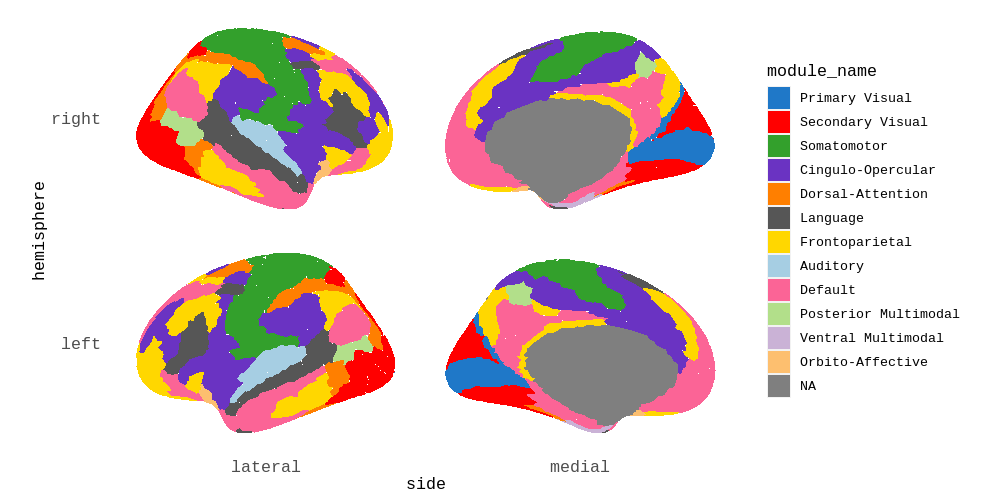

In [1897]:
%%R -i df_modules -w 10 -h 5 -u in -r 100
library(pals)
df_modules %>% rename(region=label) %>% 
mutate(module_name = factor(module_name, ordered=T, levels=unique(.$module_name))) %>% 
ggseg(atlas=glasser, position='stack',mapping=aes(fill=module_name)) + 
scale_fill_manual(values=cols25(12))

## Plot networks

In [177]:
modules = modules_louvain
leftright_flag = np.concatenate([np.ones(180)*100,np.ones(180)*200])
modules_leftright = {
    name:np.array([a+b for a,b in zip(leftright_flag, modules_)])
    for name,modules_ in modules.items()
}

networks_sorted = {name:net[modules_leftright[name].argsort(),:][:,modules_leftright[name].argsort()]
                   for name, net in networks.items()}

In [178]:
networks_df = (pd.DataFrame({name:net.flatten() for name, net in networks_sorted.items()}, 
                index=pd.MultiIndex.from_product([range(360),range(360)], names=['x','y']))
                # .apply(lambda x: x/np.std(x))
                # .apply(lambda x: (x-np.mean(x))/np.std(x))
                # .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=np.quantile(x,.01)))
                )
networks_df_plot = (networks_df
                    .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=None))#np.quantile(x,.05)))
                    # .apply(lambda x: x/np.std(x))
                    .apply(lambda x: x/np.max(x))
                    # .apply(lambda x: (x-np.mean(x))/np.std(x))
                    .reset_index()
)

networks_df_plot.describe()

,x,y,MIND_CT_MC_SA_SD_Vol,MIND_CT,MIND_MC,FC,MPC
count,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000
mean,179.500000,179.500000,0.561107,0.646480,0.659584,0.332901,0.505017
std,103.923048,103.923048,0.174396,0.210445,0.186044,0.221004,0.291515
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,89.750000,89.750000,0.431193,0.484155,0.532379,0.164168,0.252573
50%,179.500000,179.500000,0.548377,0.678171,0.682948,0.290140,0.505082
75%,269.250000,269.250000,0.682433,0.821869,0.802013,0.466863,0.757591
max,359.000000,359.000000,1.000000,1.000000,1.000000,1.000000,1.000000


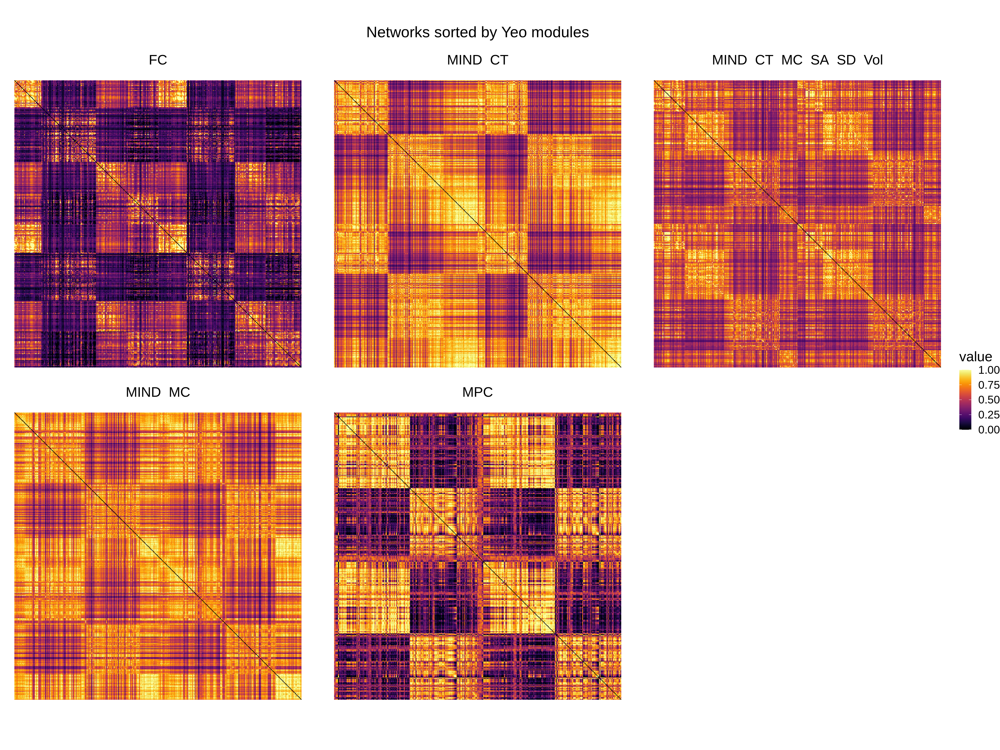

In [179]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Yeo modules')

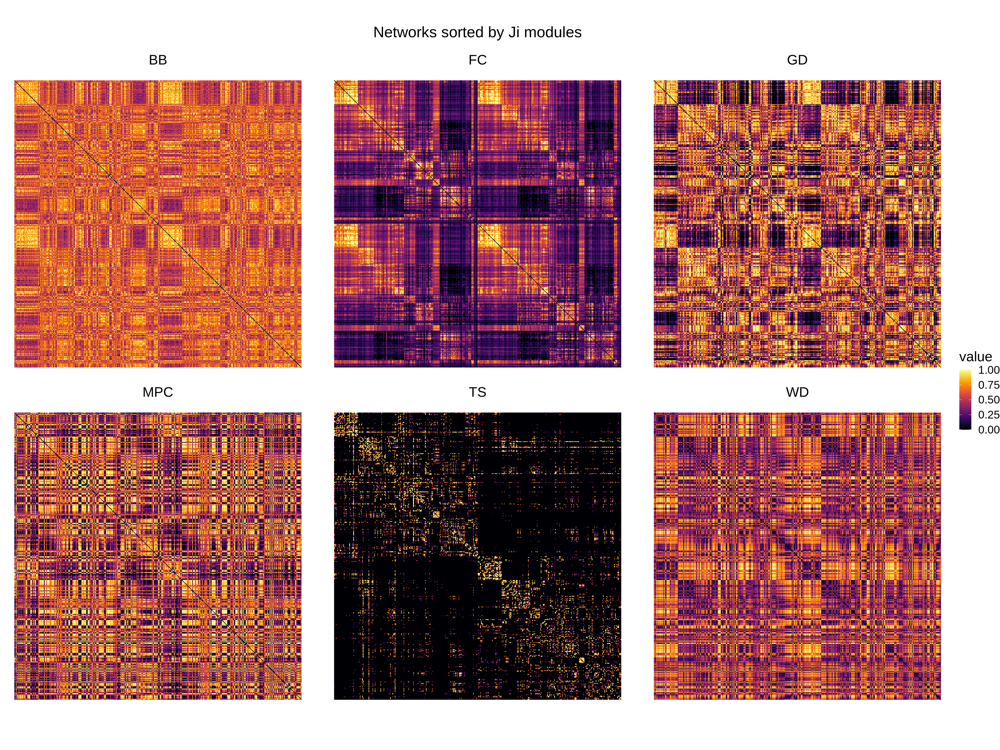

In [125]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Ji modules')

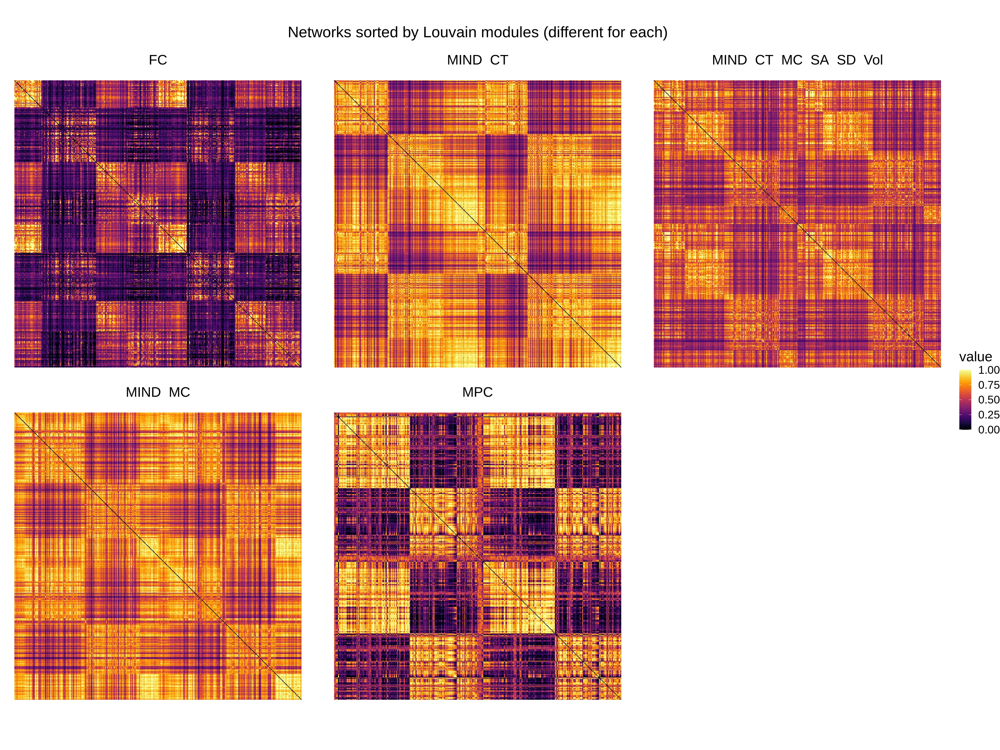

In [180]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Louvain modules (different for each)')

## All measures correlations

In [258]:
metrics_dict = {
    # 'degree (top 10%)': degree_10,
    # 'degree (top 30%)': degree_30,
    'strength': strengths,
    'centrality': centrality,
    'clustering': clustering,
    # 'intermodule strength (yeo)': strengths_intermodule_yeo,
    # 'intermodule strength (louvain)': strengths_intermodule_louvain,
    # 'participation coef (yeo)': participation_yeo,
    # 'participation coef (louvain)': participation_louvain,
    # 'total distance (top 10%)': distances_bin_10,
    # 'total distance (top 30%)': distances_bin_30,
    'distance-weighted (euclidean)': distance_weighted,
    'distance-weighted (tract length)': distance_weighted_tractlength,
    # 'intermodule dist-wei str (yeo)': distances_intermodule_yeo,
    # 'intermodule dist-wei str (louvain)': distances_intermodule_louvain
}

df_metrics_corr = (pd.concat(metrics_dict)
 .melt(ignore_index=False, var_name='network', value_name='value')
 .set_index('network',append=True)
 .unstack(0)
 .droplevel(0, axis=1)
 .loc[:, metrics_dict.keys()]
 .groupby('network').corr()
 .melt(ignore_index=False, var_name='y', value_name='r')
 .reset_index().rename({'level_1':'x'}, axis=1)
)
df_metrics_corr

,network,x,y,r
0,FC,strength,strength,1.000000
1,FC,centrality,strength,0.983256
2,FC,clustering,strength,0.983234
3,FC,distance-weighted (euclidean),strength,0.944227
4,FC,distance-weighted (tract length),strength,0.891902
...,...,...,...,...
120,MPC,strength,distance-weighted (tract length),0.716894
121,MPC,centrality,distance-weighted (tract length),0.631264
122,MPC,clustering,distance-weighted (tract length),0.752091
123,MPC,distance-weighted (euclidean),distance-weighted (tract length),0.768586


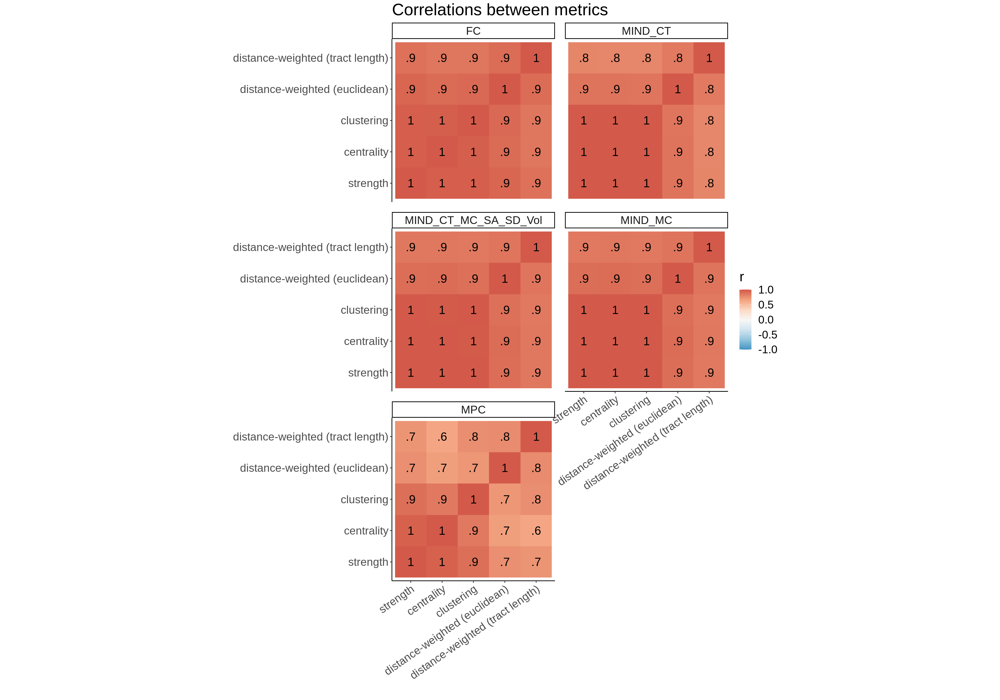

In [260]:
%%R -i df_metrics_corr -w 20 -h 14 -u in -r 200
df_metrics_corr %>%
mutate(
    x = factor(x, ordered=T, levels=unique(.$x)),
    y = factor(y, ordered=T, levels=unique(.$y))
) %>% 
ggplot(aes(x,y)) + 
facet_wrap(~network, ncol=2) +
geom_raster(aes(fill=r)) + 
geom_text(aes(label=str_replace(round(r,1), '0','')), size=6) + 
scale_fill_gradientn(colors=rev(brewer.rdbu(100)[20:80]), limits=c(-1,1)) +
xlab('') + ylab('') +
theme_classic() + 
theme(aspect.ratio=1,
    text=element_text(size=20),
    axis.text.x=element_text(angle=35, hjust=1),
    legend.position='right',
    panel.spacing=unit(1,'lines')
) +
ggtitle('Correlations between metrics')

## Node strengths

In [267]:
# pd.concat({name:pd.Series(bct.degree.strengths_und(net)) for name, net in networks.items()}, axis=1)
strengths = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()).iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = strengths

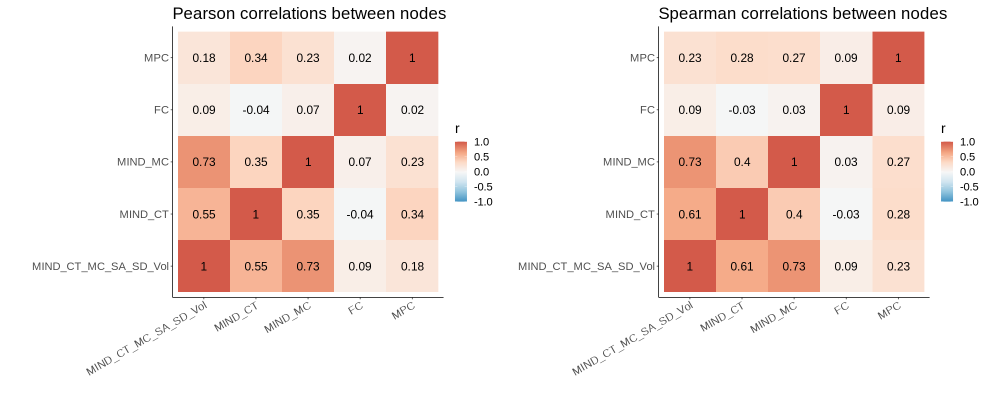

In [166]:
%%R -i strengths -w 20 -h 8 -u in -r 100

df_pearson <- strengths %>% cor %>% data.frame
df_spearman <- strengths %>% cor(method='spearman') %>% data.frame
plot_corrmat(df_pearson) + ggtitle('Pearson correlations between nodes') |
plot_corrmat(df_spearman) + ggtitle('Spearman correlations between nodes')

`geom_smooth()` using formula = 'y ~ x'


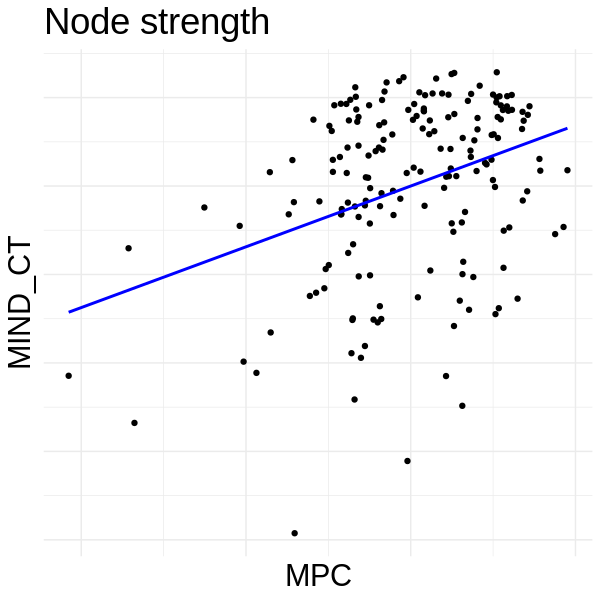

In [262]:
%%R -i strengths -w 6 -h 6 -u in -r 100
source("../code/plot_maps.R")

strengths %>% data.frame %>% 
ggplot(aes(MPC, MIND_CT)) + 
geom_point() + 
geom_smooth(method='lm', color='blue', se=F) +
theme_minimal() + 
theme(text=element_text(size=22),
        axis.text=element_blank()
) +
ggtitle('Node strength')

# g1 <- strengths %>% 
#     pivot_longer(everything(), names_to='map') %>% 
#     mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
#     ggplot(aes(value)) + facet_wrap(~map, dir='v') + 
#     xlab('node strength z-score') +
#     geom_histogram() + theme_classic()

# g2 <- plot_maps(strengths, ncol=1)
# ((g1 / g2) + plot_layout(heights=c(2,3))) & 
# theme(text=element_text(size=20))

In [268]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [269]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [270]:
strengths.corr()

,MIND_CT_MC_SA_SD_Vol,MIND_CT,MIND_MC,FC,MPC
MIND_CT_MC_SA_SD_Vol,1.000000,0.547657,0.728090,0.091539,0.183997
MIND_CT,0.547657,1.000000,0.346642,-0.039766,0.343542
MIND_MC,0.728090,0.346642,1.000000,0.065266,0.233820
FC,0.091539,-0.039766,0.065266,1.000000,0.017205
MPC,0.183997,0.343542,0.233820,0.017205,1.000000


`geom_smooth()` using formula = 'y ~ x'


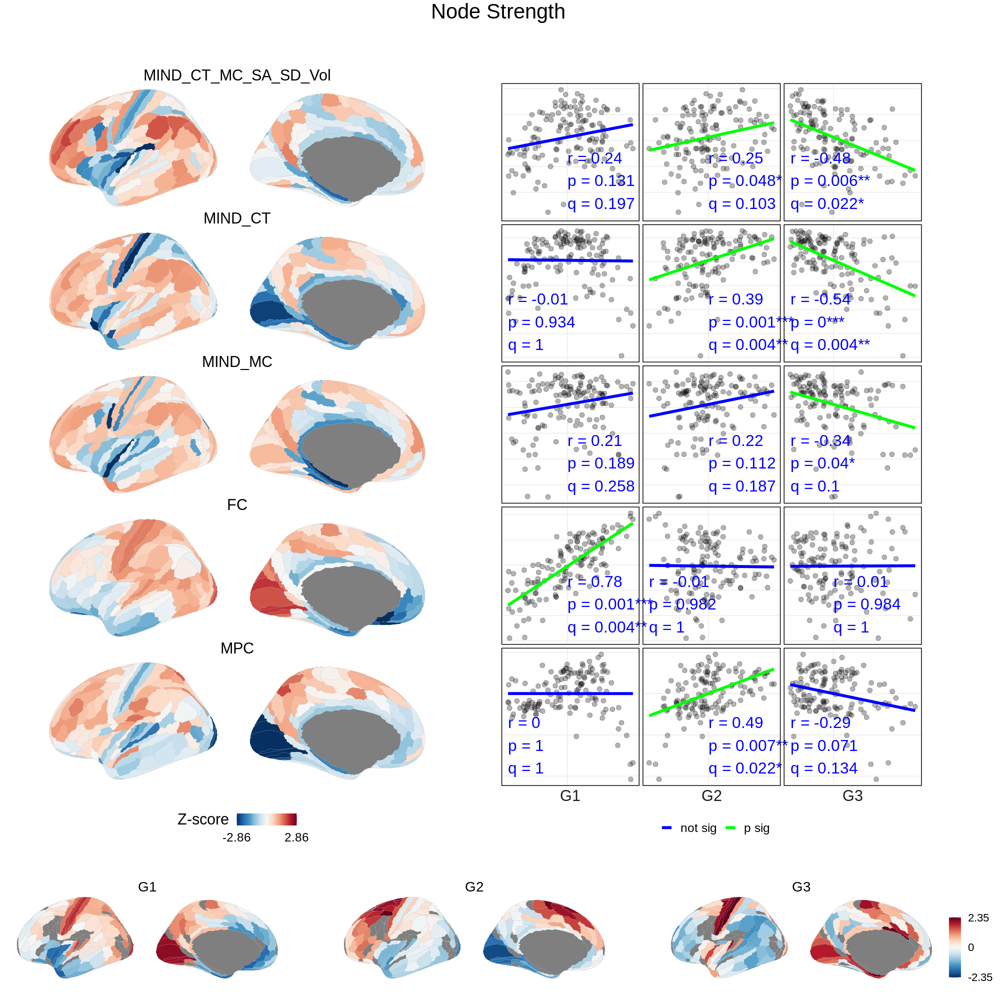

In [272]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))

# g2 <- maps %>% 
#     pivot_longer(everything(), names_to='map') %>% 
#     mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
#     ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
#     xlab('z-score') +
#     geom_histogram() + theme_bw()

g2 <- plot_maps_scatter_explore(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())

((g1 + g2) / g0) + plot_layout(heights=c(6,1)) + 
    plot_annotation(title='Node Strength', theme=theme(plot.title=element_text(size=30, hjust=.5)))
# (g1 + g3)

## Module strengths

In [19]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [25]:
modules = modules_yeo

# strengths_intra = (pd.DataFrame({name:pd.Series(edges_by_module(net, modules[name], how='intra').sum(0))
#                           for name, net in networks.items()})
#              .set_index(get_labels_hcp()[:180])
#              .apply(lambda x: (x-np.mean(x))/np.std(x))
#         )

strengths_intermodule_yeo = (
    pd.DataFrame({name:pd.Series(edges_by_module(net, modules_yeo[name], how='inter').sum(0))
                  for name, net in networks.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

strengths_intermodule_louvain = (
    pd.DataFrame({name:pd.Series(edges_by_module(net, modules_louvain[name], how='inter').sum(0))
                  for name, net in networks.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    # 'intra': strengths_intra,
    'inter': strengths_intermodule_yeo
}, axis=1).droplevel(0,axis=1)
# maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

In [26]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [27]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


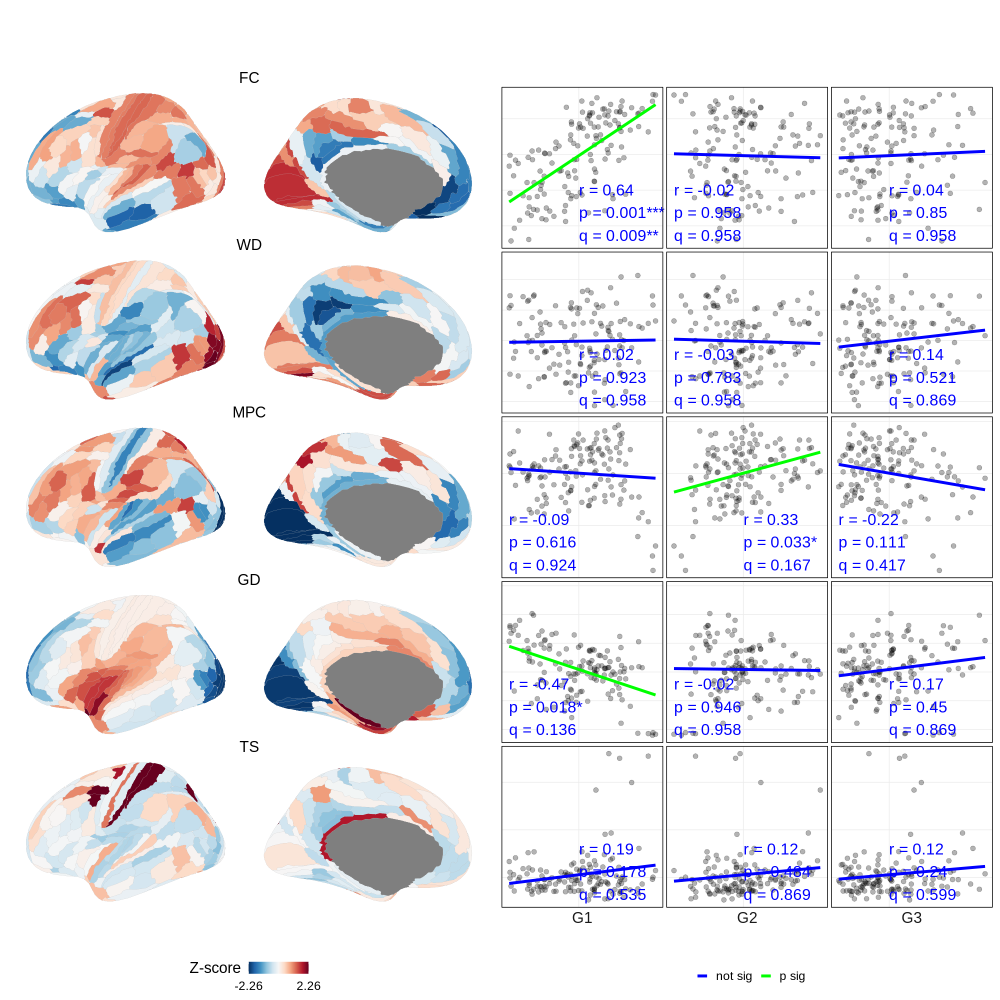

In [28]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) + theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Participation coef

In [62]:
participation_yeo = (pd.DataFrame({name:pd.Series(bct.participation_coef(net, modules_yeo[name])) 
                               for name, net in networks.items()})
                .set_index(get_labels_hcp())
                .iloc[:180,:]
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

participation_louvain = (pd.DataFrame({name:pd.Series(bct.participation_coef(net, modules_louvain[name])) 
                               for name, net in networks.items()})
                .set_index(get_labels_hcp())
                .iloc[:180,:]
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = participation_yeo

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


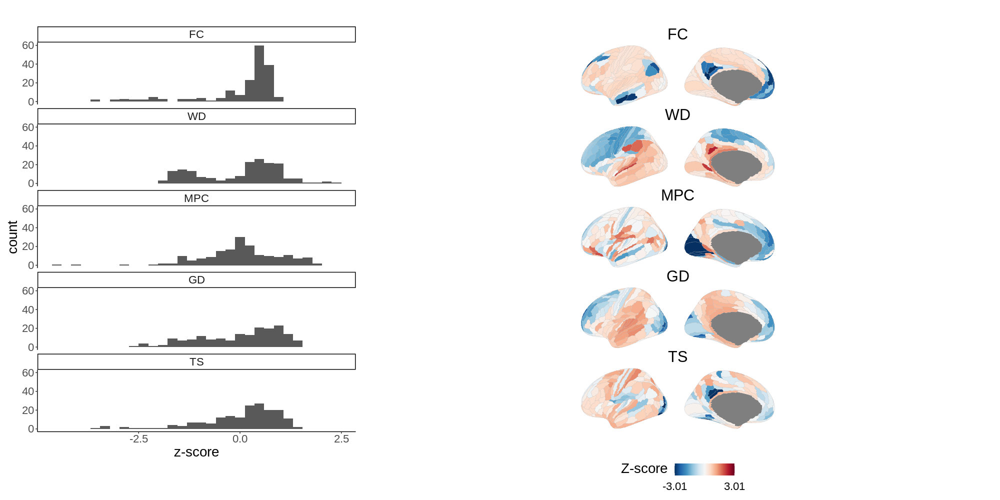

In [63]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [64]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [65]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [66]:
maps.corr()

,FC,WD,MPC,GD,TS
FC,1.000000,-0.096553,0.187609,0.184871,0.220095
WD,-0.096553,1.000000,0.044927,0.284209,-0.246295
MPC,0.187609,0.044927,1.000000,0.259487,-0.065302
GD,0.184871,0.284209,0.259487,1.000000,0.102514
TS,0.220095,-0.246295,-0.065302,0.102514,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


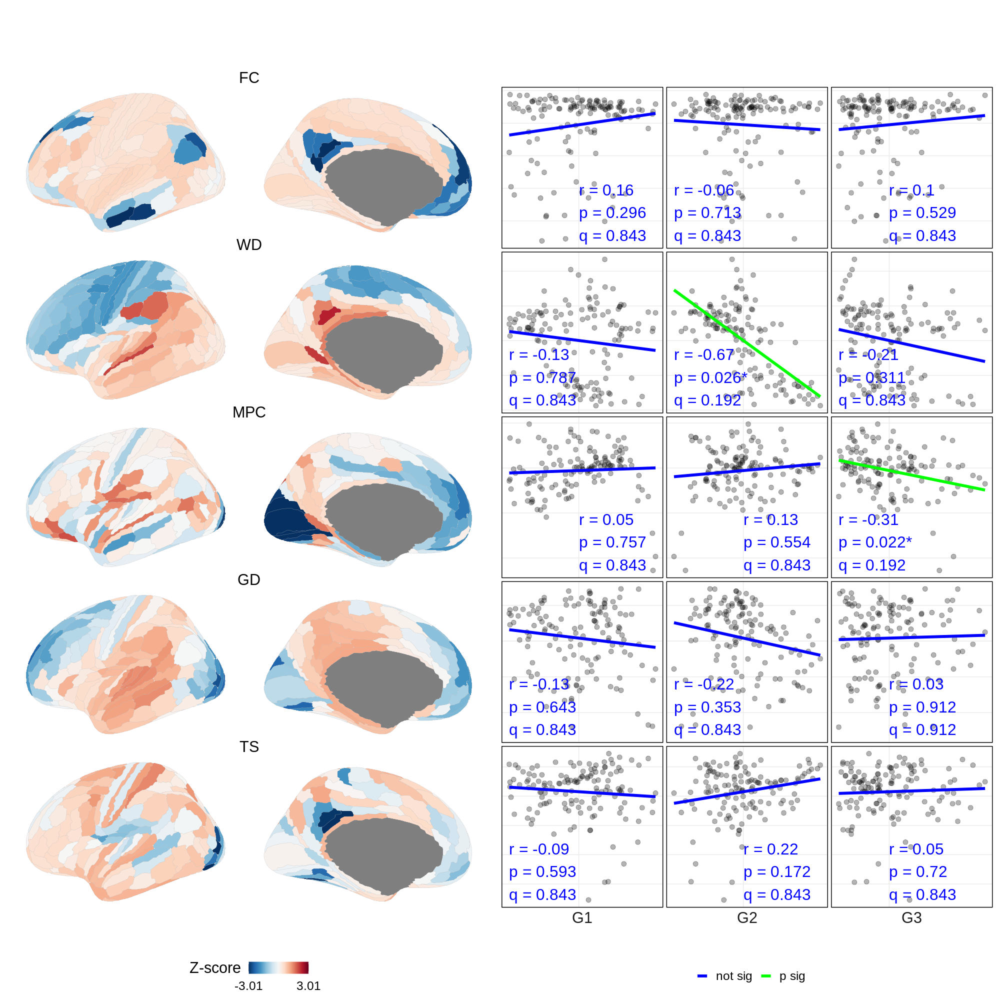

In [67]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Distance-weighted strength

In [257]:
# distance = hcp_euclidean
distance = pd.read_csv("../data/networks/paquola_WDmatrix.csv", header=None).values

distance_weighted = (pd.DataFrame({name:pd.Series((net * distance).sum(0)) 
                          for name, net in networks.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distance_weighted

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


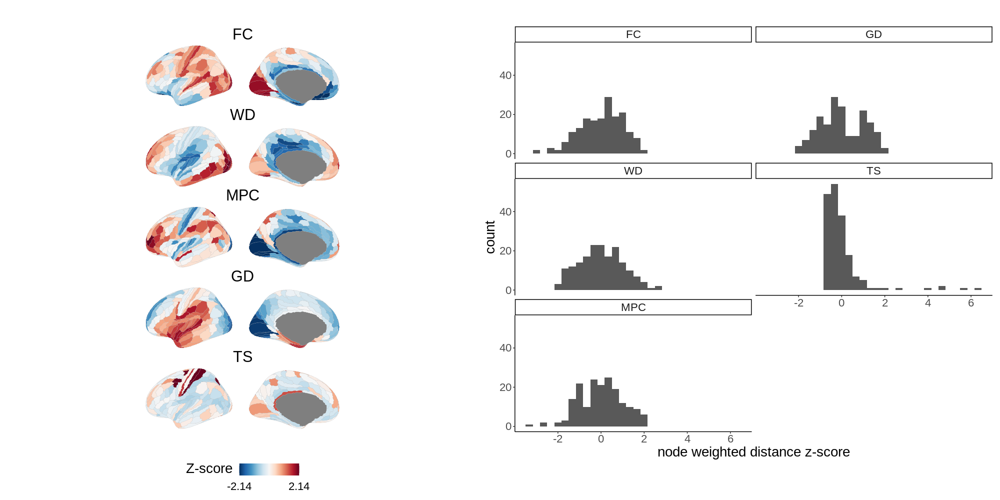

In [69]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=1)

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v') + 
    xlab('node weighted distance z-score') +
    geom_histogram() + theme_classic()

((g1 | g2) + plot_layout(heights=c(2,3))) & 
theme(text=element_text(size=20))

In [238]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [239]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

`geom_smooth()` using formula = 'y ~ x'


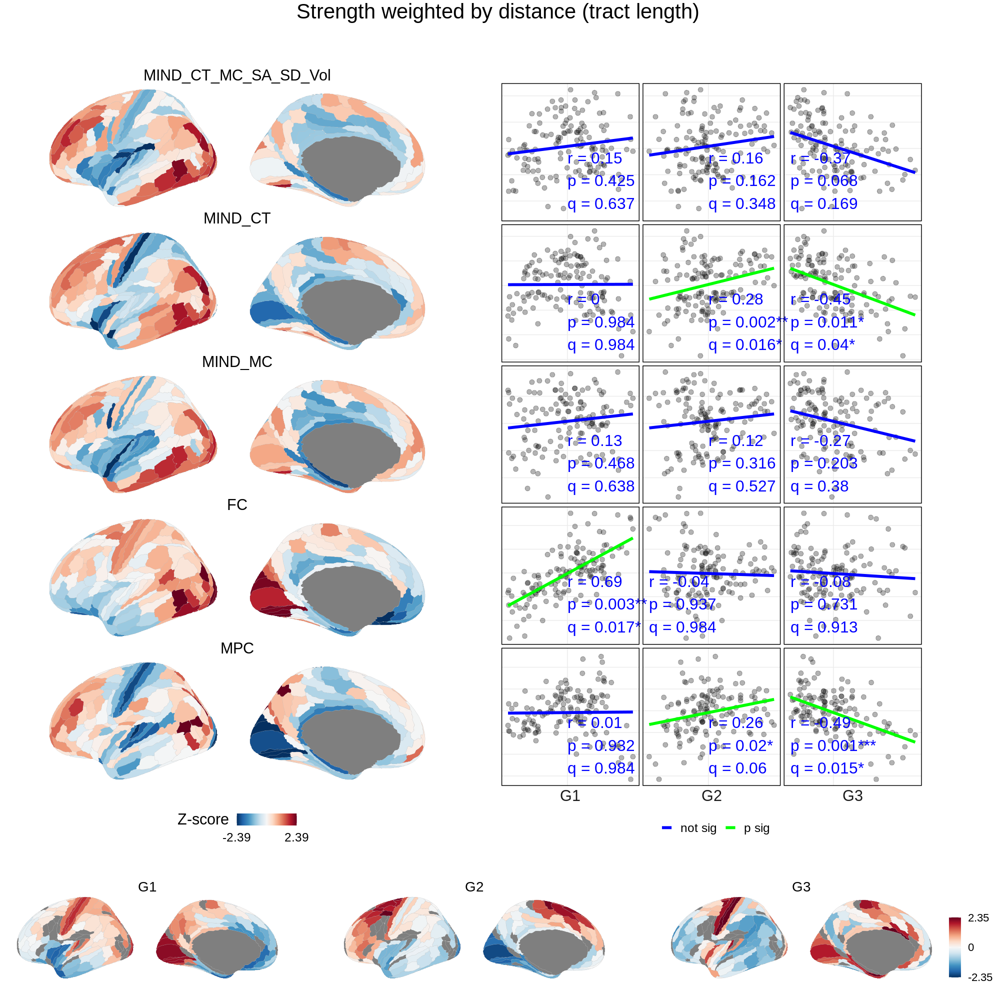

In [236]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")

g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter_explore(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())

((g1 + g2) / g0) + plot_layout(heights=c(6,1)) + 
    plot_annotation(title='Strength weighted by distance (tract length)', theme=theme(plot.title=element_text(size=30, hjust=.5)))

# g1 + g2

`geom_smooth()` using formula = 'y ~ x'


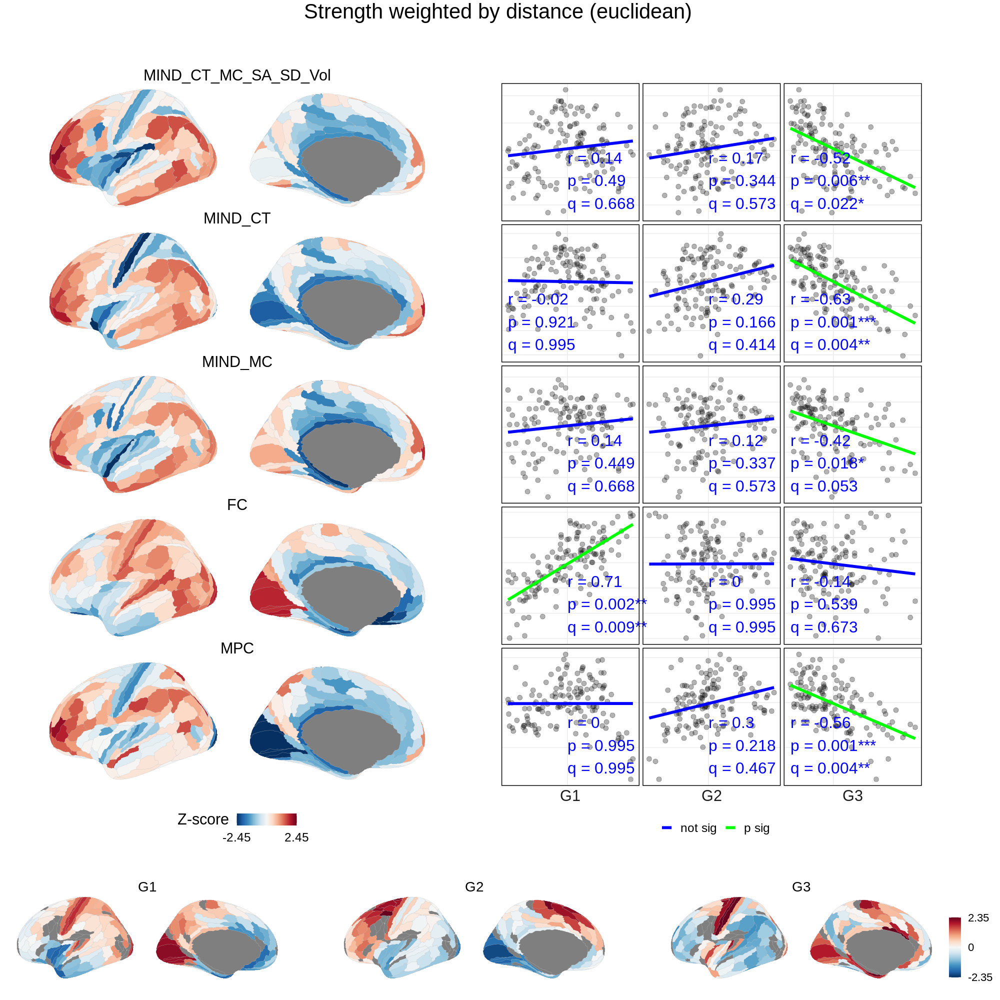

In [242]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter_explore(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())

((g1 + g2) / g0) + plot_layout(heights=c(6,1)) + 
    plot_annotation(title='Strength weighted by distance (euclidean)', theme=theme(plot.title=element_text(size=30, hjust=.5)))

# g1 + g2

## Module distances

In [29]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [44]:
distance = networks['WD']

# distances_intra = (pd.DataFrame({name:pd.Series(
#                 (distance * edges_by_module(net, modules[name], how='intra')).sum(0))
#                           for name, net in networks.items()})
#              .set_index(get_labels_hcp())
#              .iloc[:180,:]
#              .apply(lambda x: (x-np.mean(x))/np.std(x))
#         )

distances_intermodule_yeo = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules_yeo[name], how='inter')).sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

distances_intermodule_louvain = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules_louvain[name], how='inter')).sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    # 'intra': distances_intra,
    'inter': distances_intermodule_yeo
}, axis=1).droplevel(0, axis=1)
# maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

maps
    

,FC,WD,MPC,GD,TS
label,,,,,
V1,1.840830,0.232742,-1.765827,-1.673191,0.810965
MST,1.082990,0.704479,0.620855,-1.011659,-0.619451
V6,0.935914,0.426718,0.309126,-0.859349,-0.190008
V2,2.375074,0.946712,-2.764722,-1.688191,0.304197
V3,2.404564,1.362117,-2.124489,-1.792681,0.153794
...,...,...,...,...,...
STSva,-1.180714,-0.996026,-1.768802,-0.267189,-0.291608
TE1m,-1.332250,1.167787,-0.766582,0.232170,-0.079727
PI,0.254403,0.315909,-0.026398,2.442108,-0.595003


In [45]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [46]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


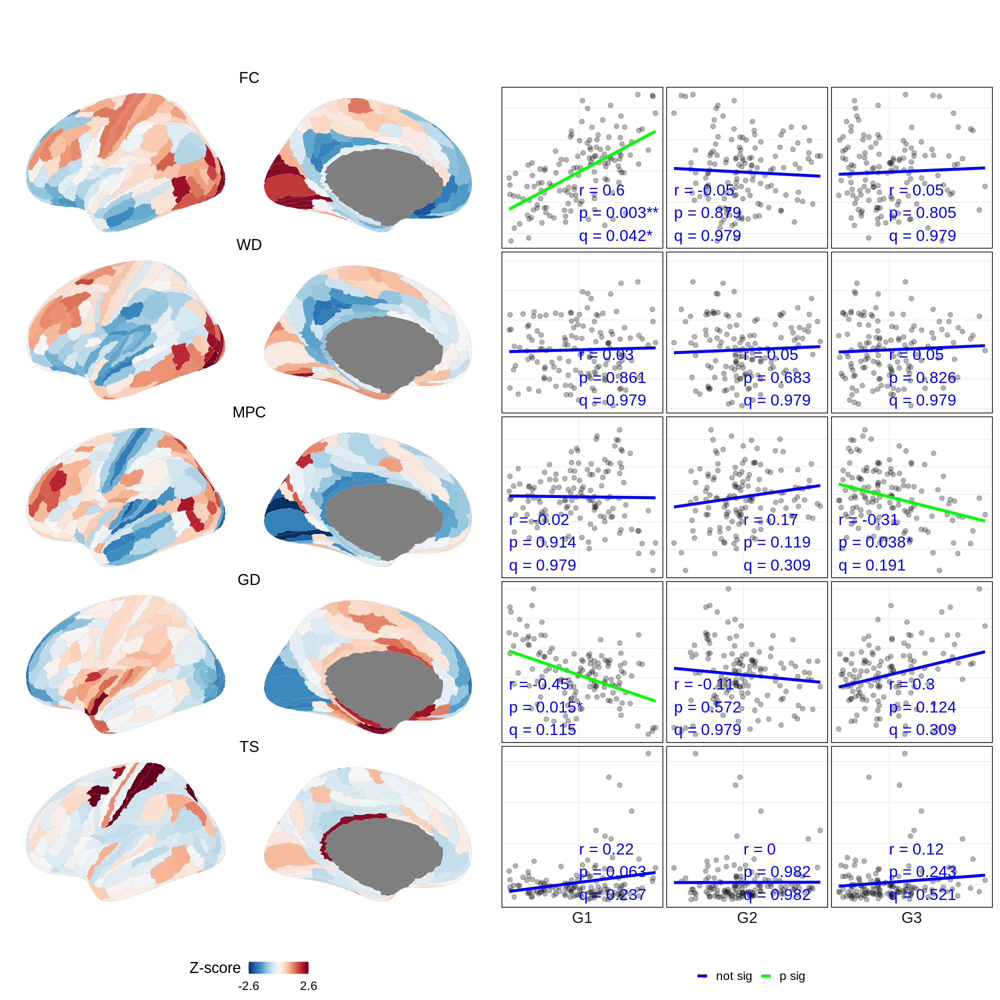

In [47]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Betweeness

In [1499]:
betweenness = (pd.DataFrame({name:pd.Series(bct.betweenness_wei(net)) 
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = betweenness

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


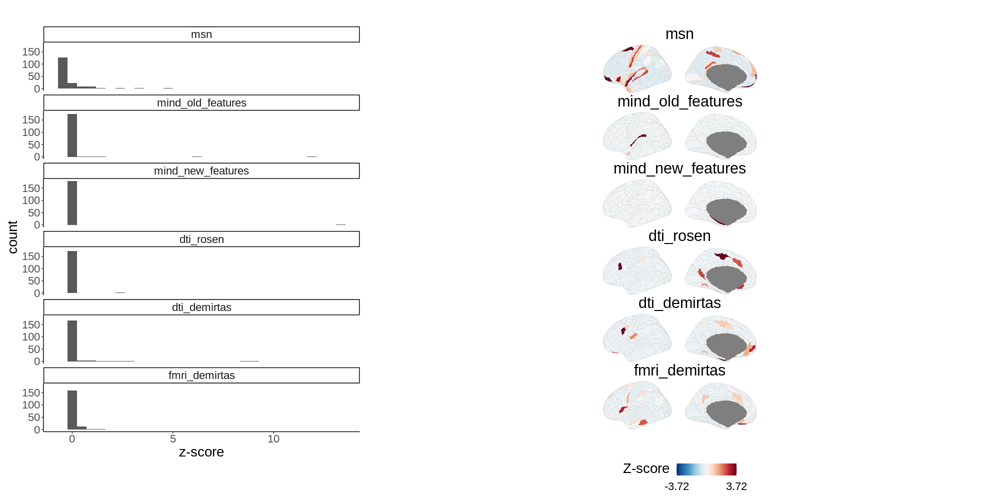

In [1500]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [ ]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [ ]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [ ]:
maps.corr()

,msn,mind_old_features,mind_new_features,fmri_connectivity
msn,1.000000,-0.325357,-0.190311,-0.042790
mind_old_features,-0.325357,1.000000,0.305364,0.013747
mind_new_features,-0.190311,0.305364,1.000000,0.222082
fmri_connectivity,-0.042790,0.013747,0.222082,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


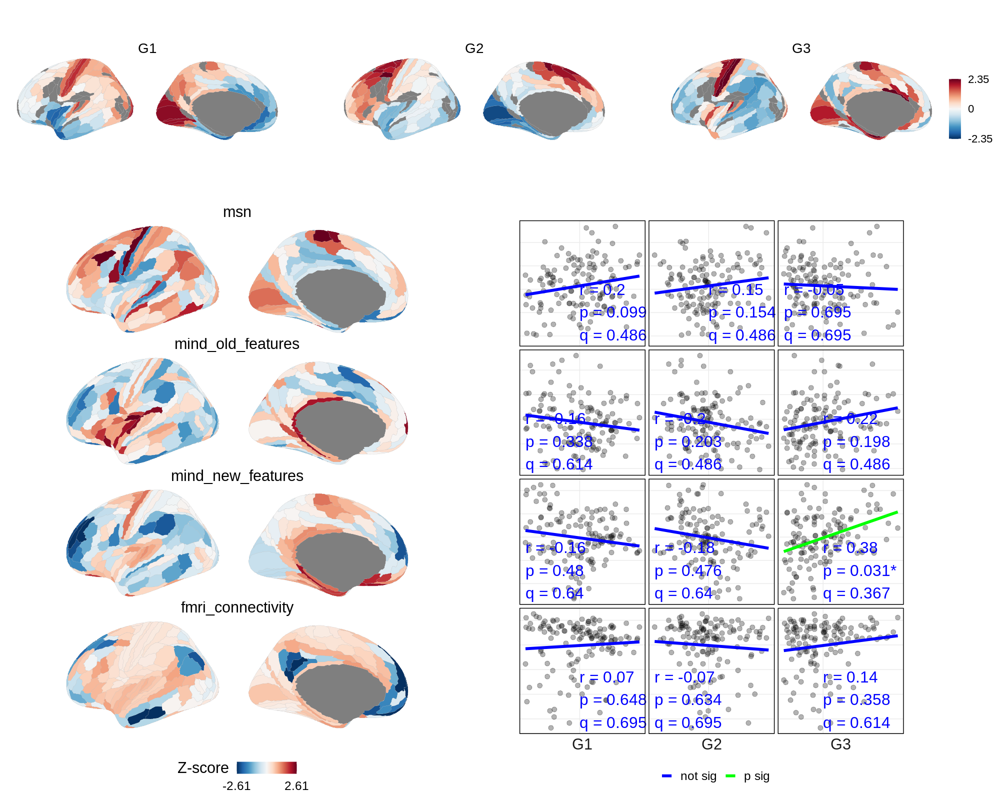

In [ ]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 16 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
(g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

## Eigenvector centrality

In [252]:
centrality = (pd.DataFrame({name:pd.Series(bct.eigenvector_centrality_und(net))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp())
                .iloc[:180]
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = centrality

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


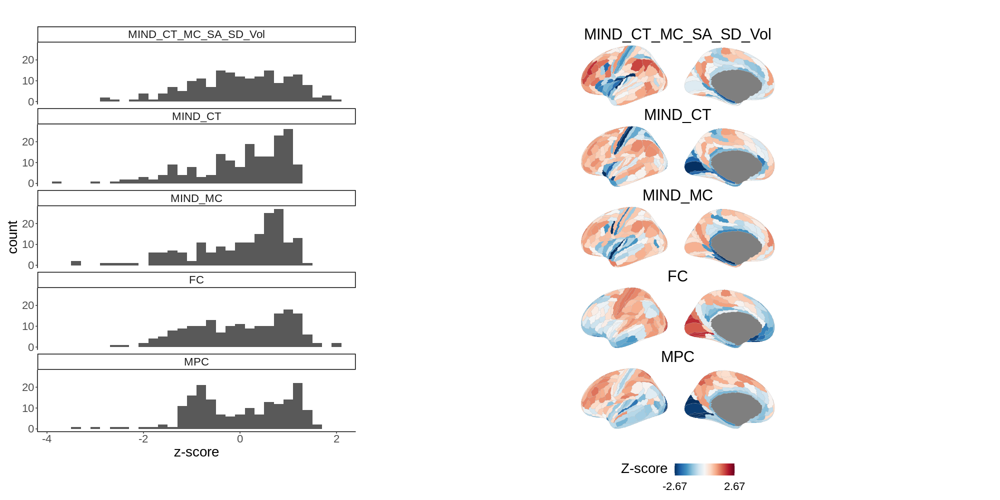

In [207]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [253]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [254]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [255]:
maps.corr()

,MIND_CT_MC_SA_SD_Vol,MIND_CT,MIND_MC,FC,MPC
MIND_CT_MC_SA_SD_Vol,1.000000,0.532986,0.733163,0.015030,0.169231
MIND_CT,0.532986,1.000000,0.336160,-0.093584,0.289168
MIND_MC,0.733163,0.336160,1.000000,0.013012,0.224478
FC,0.015030,-0.093584,0.013012,1.000000,0.055168
MPC,0.169231,0.289168,0.224478,0.055168,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


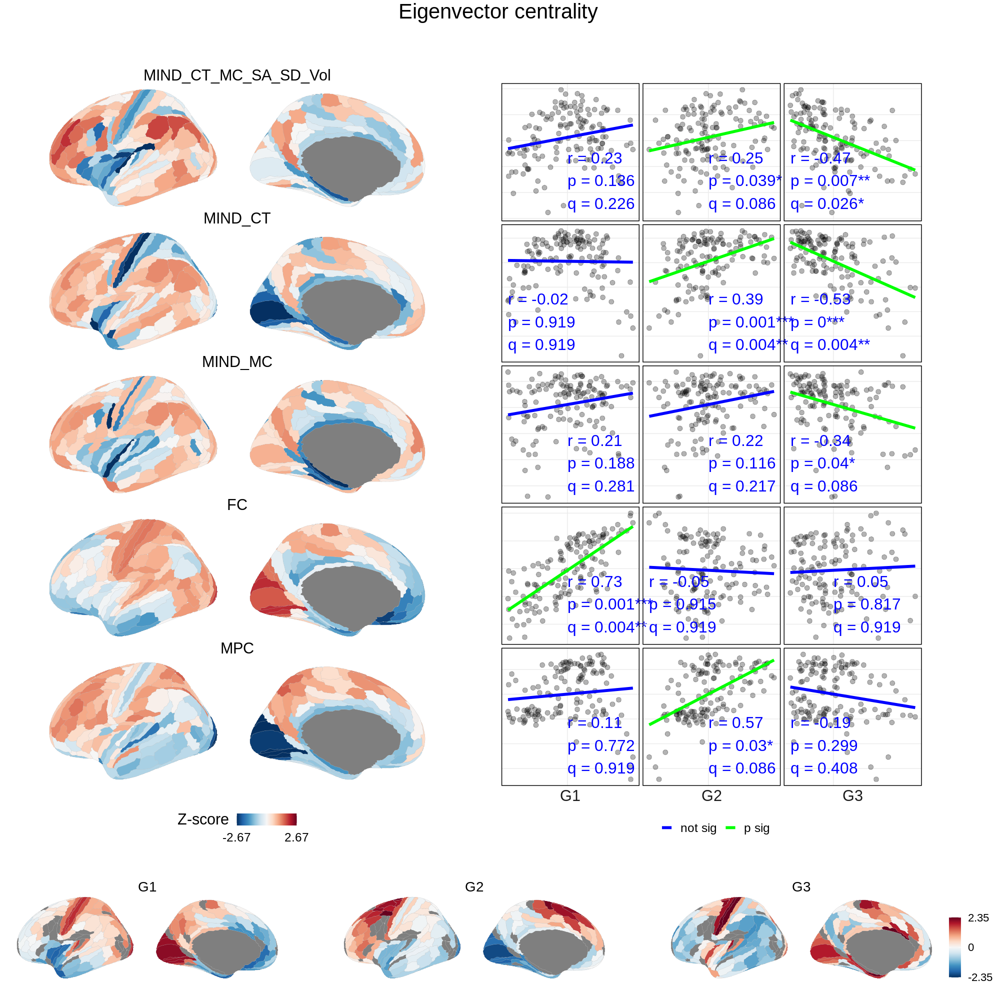

In [256]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter_explore(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())

# g1 + g2
((g1 + g2) / g0) + plot_layout(heights=c(6,1)) + 
    plot_annotation(title='Eigenvector centrality', theme=theme(plot.title=element_text(size=30, hjust=.5)))

## Clustering coef

In [ ]:
clustering = (pd.DataFrame({name:pd.Series(bct.clustering_coef_wu(net))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp())
                .iloc[:180]
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = clustering

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


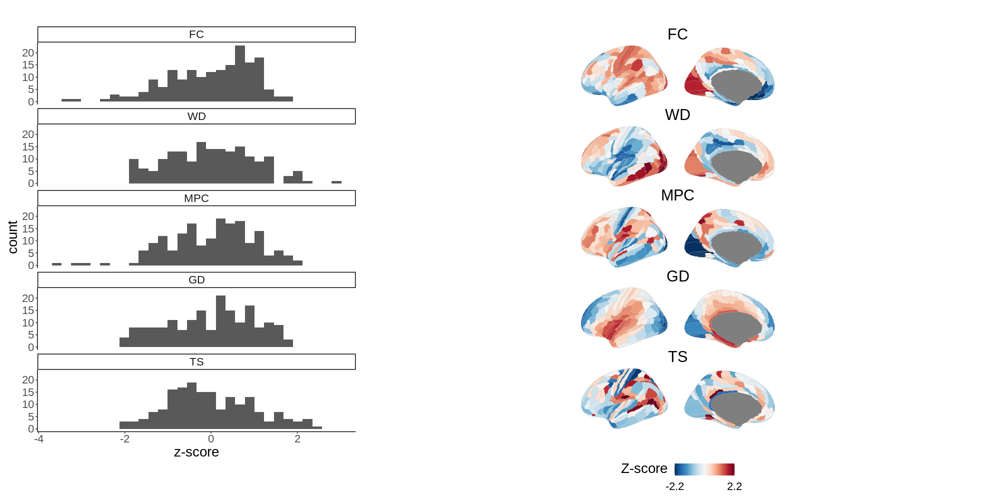

In [80]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [ ]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [247]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [248]:
maps.corr()

,MIND_CT_MC_SA_SD_Vol,MIND_CT,MIND_MC,FC,MPC
MIND_CT_MC_SA_SD_Vol,1.000000,0.532986,0.733163,0.015030,0.169231
MIND_CT,0.532986,1.000000,0.336160,-0.093584,0.289168
MIND_MC,0.733163,0.336160,1.000000,0.013012,0.224478
FC,0.015030,-0.093584,0.013012,1.000000,0.055168
MPC,0.169231,0.289168,0.224478,0.055168,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


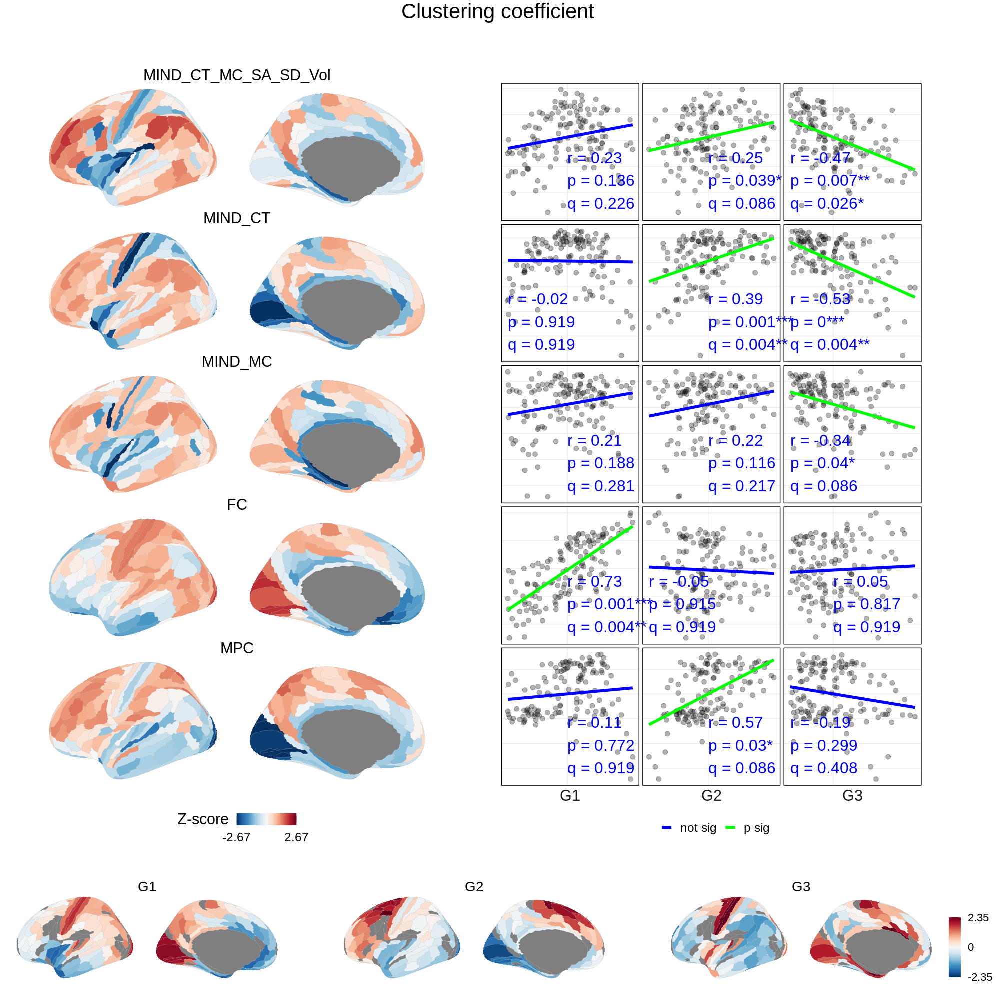

In [251]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter_explore(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())

# g1 + g2
((g1 + g2) / g0) + plot_layout(heights=c(6,1)) + 
    plot_annotation(title='Clustering coefficient', theme=theme(plot.title=element_text(size=30, hjust=.5)))

## Path length

In [797]:
net = networks['mind_old_features']
bct.distance_wei(1/net)[0].sum(0)

/tmp/ipykernel_55371/2592204634.py:2: RuntimeWarning: divide by zero encountered in true_divide
  bct.distance_wei(1/net)[0].sum(0)


array([1649.31411463, 1762.38123014, 1589.63337205, 1633.06483926,
       1466.60513505, 1360.46606357, 1400.07158165, 1325.45455001,
       2044.11647043, 1412.10536419, 1492.69396498, 1530.59029288,
       1659.01724508, 1790.82661377, 1361.35796468, 1601.73316601,
       1643.5813153 , 1345.29801395, 1967.89704739, 1487.41363763,
       1621.69051257, 1677.72388899, 1458.73769581, 1971.25301075,
       1348.18660265, 1814.59616472, 1382.2049675 , 1514.42468254,
       1719.81828204, 1391.17464724, 1298.41457721, 1787.1447806 ,
       1611.57550246, 1813.51145516, 1620.40029239, 1857.07525857,
       1896.20329902, 1744.27304477, 1813.2816065 , 1426.87076033,
       1760.88227369, 1719.12519556, 1481.19367738, 1488.24468036,
       1662.40893783, 1901.35070636, 1596.14777269, 1533.02148265,
       1718.88818685, 1591.5525885 , 1934.45139414, 1459.17557562,
       1950.16638314, 1617.28486996, 1508.47698673, 1943.80169997,
       1624.94540611, 1932.64555797, 1716.55477137, 1891.13073

In [2149]:
path_length = (pd.DataFrame({name:pd.Series(bct.distance_wei(1/net)[0].sum(0))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp())
                .iloc[:180]
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = path_length

/tmp/ipykernel_55371/1840609358.py:1: RuntimeWarning: divide by zero encountered in true_divide
  path_length = (pd.DataFrame({name:pd.Series(bct.distance_wei(1/net)[0].sum(0))


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


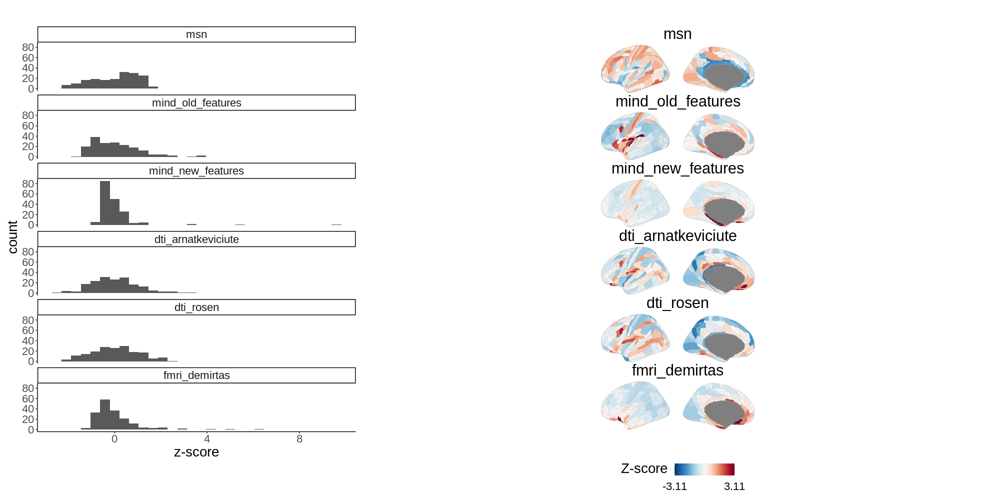

In [2150]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [2151]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [2152]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [2153]:
maps.corr()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,-0.130584,-0.029193,-0.217051,-0.070112,-0.358536
mind_old_features,-0.130584,1.000000,0.374373,0.115440,0.169629,0.206671
mind_new_features,-0.029193,0.374373,1.000000,0.009968,-0.115856,0.438793
dti_arnatkeviciute,-0.217051,0.115440,0.009968,1.000000,0.747584,0.371417
dti_rosen,-0.070112,0.169629,-0.115856,0.747584,1.000000,0.065438
fmri_demirtas,-0.358536,0.206671,0.438793,0.371417,0.065438,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


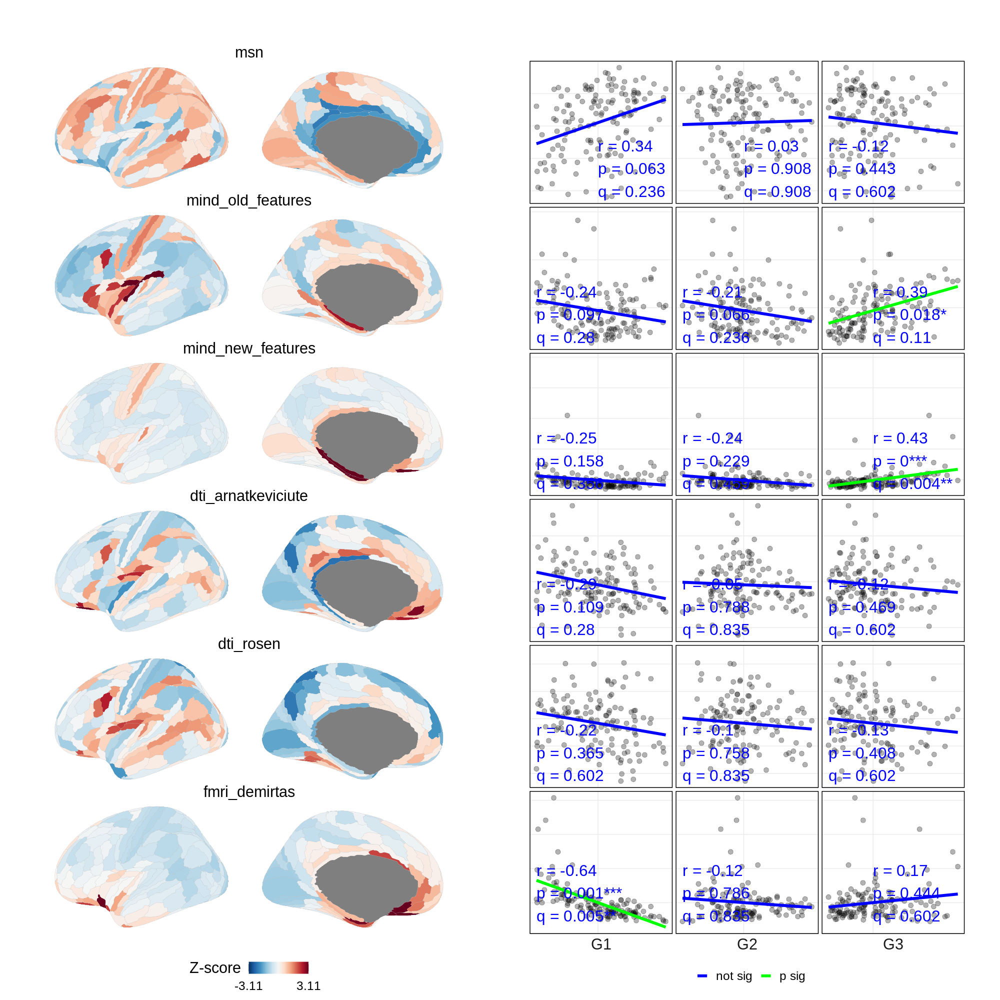

In [2154]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Module distances only (no weights)

In [678]:
blank_network = {'blank': np.ones([180,180])}
modules['blank'] = modules['mind_new_features']

In [679]:
distance = hcp_geodesic

distances_intra = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='intra')).sum(0))
                          for name, net in blank_network.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

distances_inter = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='inter')).sum(0))
                          for name, net in blank_network.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    'intra': distances_intra,
    'inter': distances_inter
}, axis=1)
maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

maps

,intra-blank,inter-blank
label,,
V1,-0.053346,1.654381
MST,-1.288103,0.395441
V6,-0.934833,1.104846
V2,-0.159636,1.476343
V3,-0.343631,1.393380
...,...,...
STSva,-1.313254,1.297990
TE1m,-0.100974,0.598305
PI,-1.548216,0.215571


In [680]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [681]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


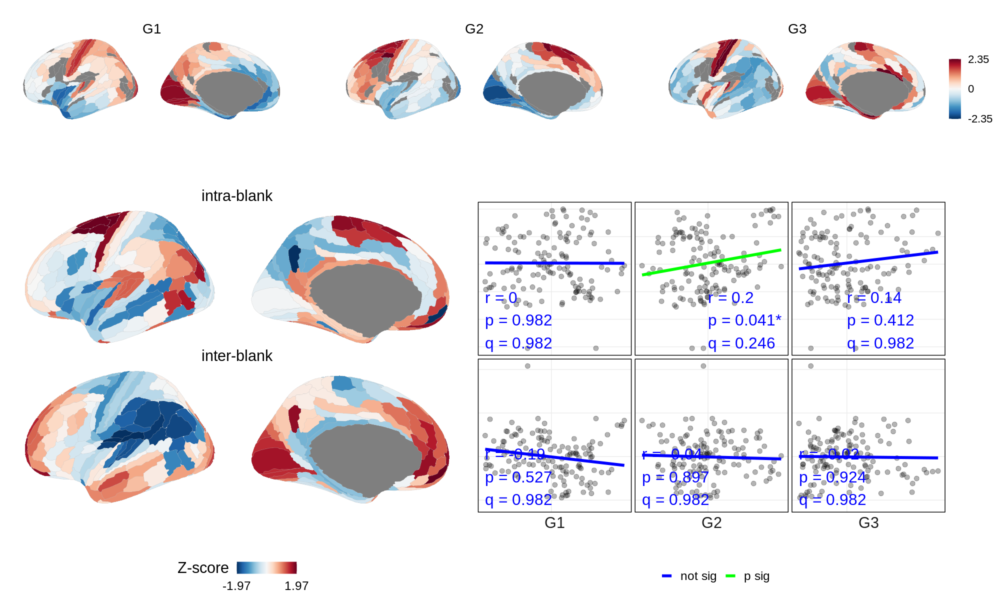

In [682]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 12 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
(g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

## Binary networks

https://www.pnas.org/doi/10.1073/pnas.2013232118

In [56]:
networks_bin_30 = {name:np.where(net > np.nanquantile(net, .70), 1, 0)
                for name, net in networks.items()}

networks_bin_10 = {name:np.where(net > np.nanquantile(net, .90), 1, 0)
                for name, net in networks.items()}

networks_bin_03 = {name:np.where(net > np.nanquantile(net, .97), 1, 0)
                for name, net in networks.items()}

In [49]:
import bct
gamma = 1.06

modules_louvain_bin = {
    name:bct.community_louvain(net, gamma=gamma, seed=1)[0] 
    # name:bct.modularity_louvain_und(net, gamma=gamma)[0] 
    for name, net in networks_bin.items()
}
modules_louvain_bin['MPC'].shape

(360,)

In [50]:
modules = modules_yeo
leftright_flag = np.concatenate([np.ones(180)*100,np.ones(180)*200])
modules_leftright = {
    name:np.array([a+b for a,b in zip(leftright_flag, modules_)])
    for name,modules_ in modules.items()
}

networks_sorted = {name:net[modules_leftright[name].argsort(),:][:,modules_leftright[name].argsort()]
                   for name, net in networks_bin.items()}

In [51]:
networks_df = (pd.DataFrame({name:net.flatten() for name, net in networks_sorted.items()}, 
                index=pd.MultiIndex.from_product([range(360),range(360)], names=['x','y']))
                # .apply(lambda x: x/np.std(x))
                # .apply(lambda x: (x-np.mean(x))/np.std(x))
                # .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=np.quantile(x,.01)))
                )
networks_df_plot = (networks_df
                    .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=None))#np.quantile(x,.05)))
                    # .apply(lambda x: x/np.std(x))
                    .apply(lambda x: x/np.max(x))
                    # .apply(lambda x: (x-np.mean(x))/np.std(x))
                    .reset_index()
)

networks_df_plot.describe()

,x,y,FC,WD,MPC,GD,TS
count,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000,129600.000000
mean,179.500000,179.500000,0.300000,0.300000,0.300000,0.300000,0.121250
std,103.923048,103.923048,0.458259,0.458259,0.458259,0.458259,0.326419
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,89.750000,89.750000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,179.500000,179.500000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,269.250000,269.250000,1.000000,1.000000,1.000000,1.000000,0.000000
max,359.000000,359.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [52]:
networks_df.corr()

,FC,WD,MPC,GD,TS
FC,1.000000,-0.091564,0.120664,0.150096,0.141948
WD,-0.091564,1.000000,-0.415123,-0.321869,-0.103797
MPC,0.120664,-0.415123,1.000000,0.207966,0.149892
GD,0.150096,-0.321869,0.207966,1.000000,0.244548
TS,0.141948,-0.103797,0.149892,0.244548,1.000000


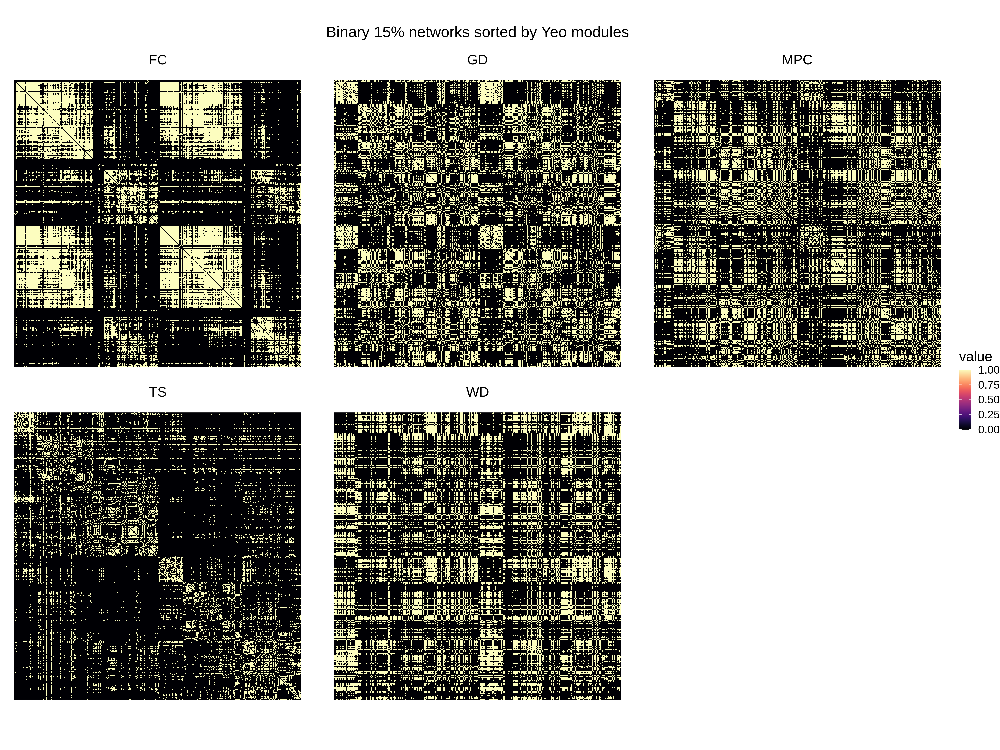

In [53]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=magma(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Binary 15% networks sorted by Yeo modules')

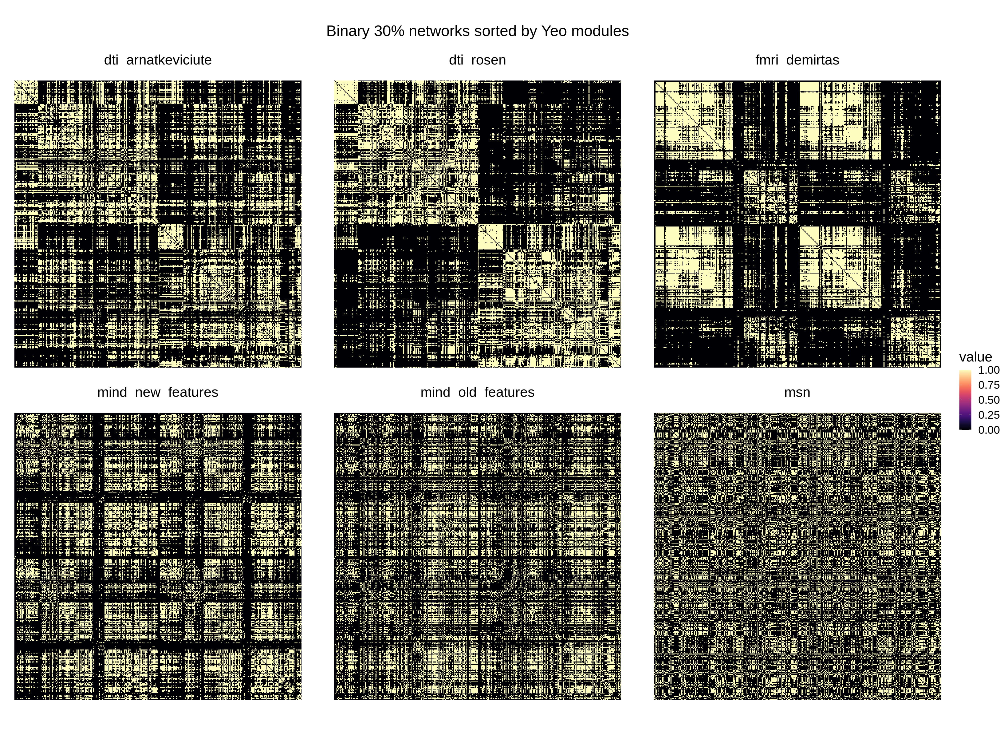

In [2455]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=magma(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Binary 30% networks sorted by Yeo modules')

## Thresholded strengths

In [58]:
degree_03 = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks_bin_03.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

degree_10 = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks_bin_10.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

degree_30 = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks_bin_30.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = degree_30

In [59]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [60]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


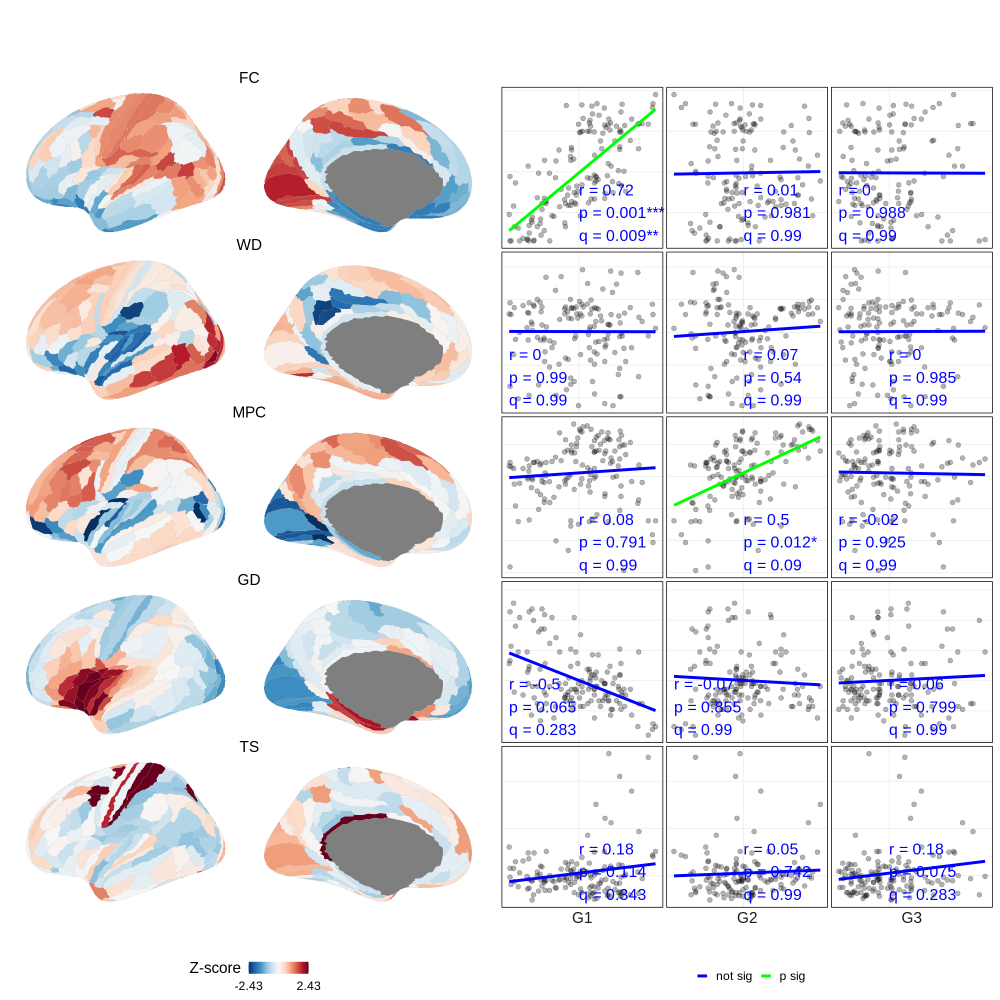

In [61]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))
g1 + g2

## Thresholded distances

In [2819]:
distances_bin_10 = (pd.DataFrame({name:pd.Series((hcp_euclidean * net).sum(0)) 
                          for name, net in networks_bin_10.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

distances_bin_30 = (pd.DataFrame({name:pd.Series((hcp_euclidean * net).sum(0)) 
                          for name, net in networks_bin_30.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distances_bin_10

In [2650]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [2651]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


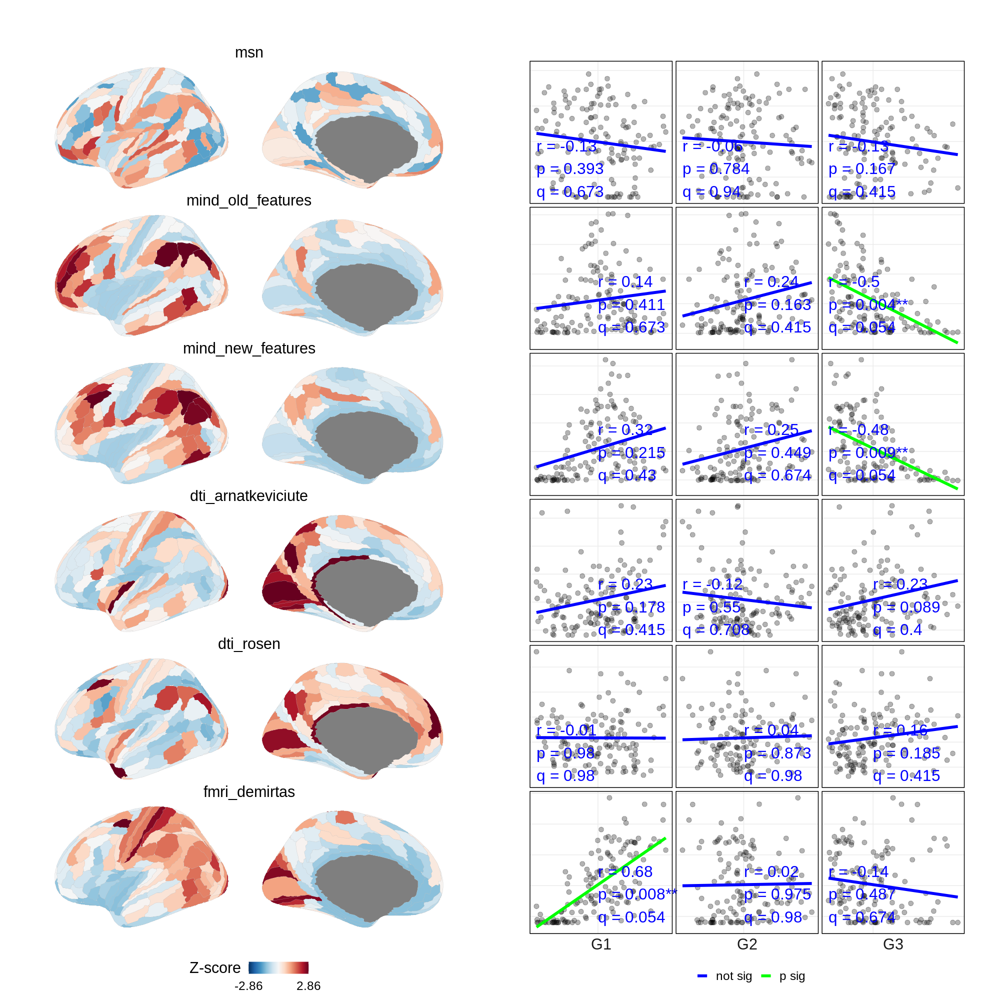

In [2652]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Thresholded intermodule distance

In [2065]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [2066]:
modules = modules_yeo

distances = (pd.DataFrame({name:pd.Series((hcp_euclidean * edges_by_module(net, modules[name], how='inter')).sum(0)) 
                          for name, net in networks_bin.items()})
             .set_index(get_labels_hcp())
             .iloc[:180]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distances

In [2067]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [2068]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


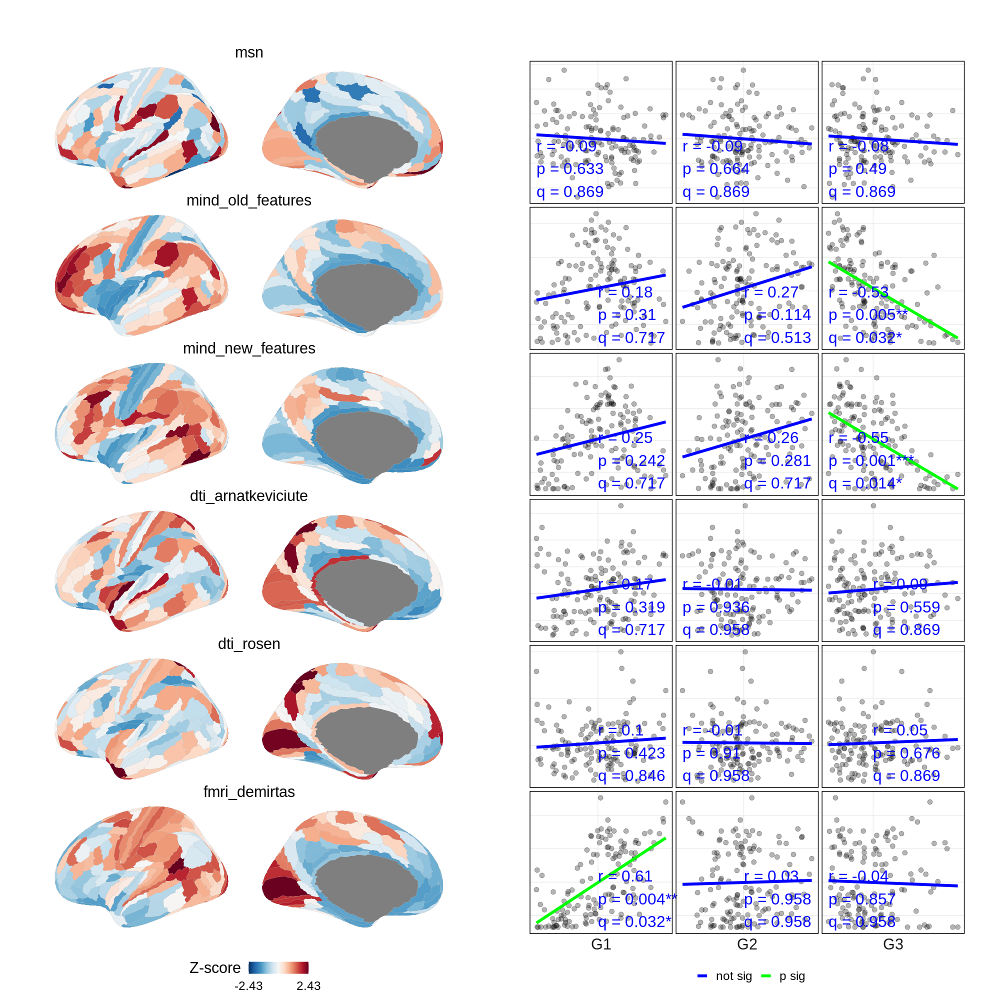

In [2069]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Chen model for axonal connectivity

In [2702]:
def get_axon_length(net, distances=hcp_euclidean, beta=0.03):
    with np.errstate(divide='ignore',invalid='ignore'):
        d_i = (net * distances).sum(0) / net.sum(0)
    w_i = np.exp(-beta * d_i)
    D_i = (net * distances).sum(0)
    rTAPL = w_i * D_i
    return(rTAPL)
    # return(w_i)

get_axon_length(networks['dti_arnatkeviciute'])[:10]

array([1133.12932758,  644.54520108, 1077.55531562, 1118.5405699 ,
       1054.87543387,  921.99467219,  628.27893664, 1260.80048279,
        989.99912411,  932.20154055])

In [2703]:
distance = hcp_tract_lengths
beta = 0.03
networks_bin_10 = {name:np.where(net > np.nanquantile(net, .90), 1, 0)
                  for name, net in networks.items()}

axon_length = (pd.DataFrame({name:pd.Series(get_axon_length(net, distances=distance, beta=beta))
                          for name, net in networks_bin_10.items()})
             .set_index(get_labels_hcp())
             .iloc[:180,:]
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = axon_length

In [2704]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [2705]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


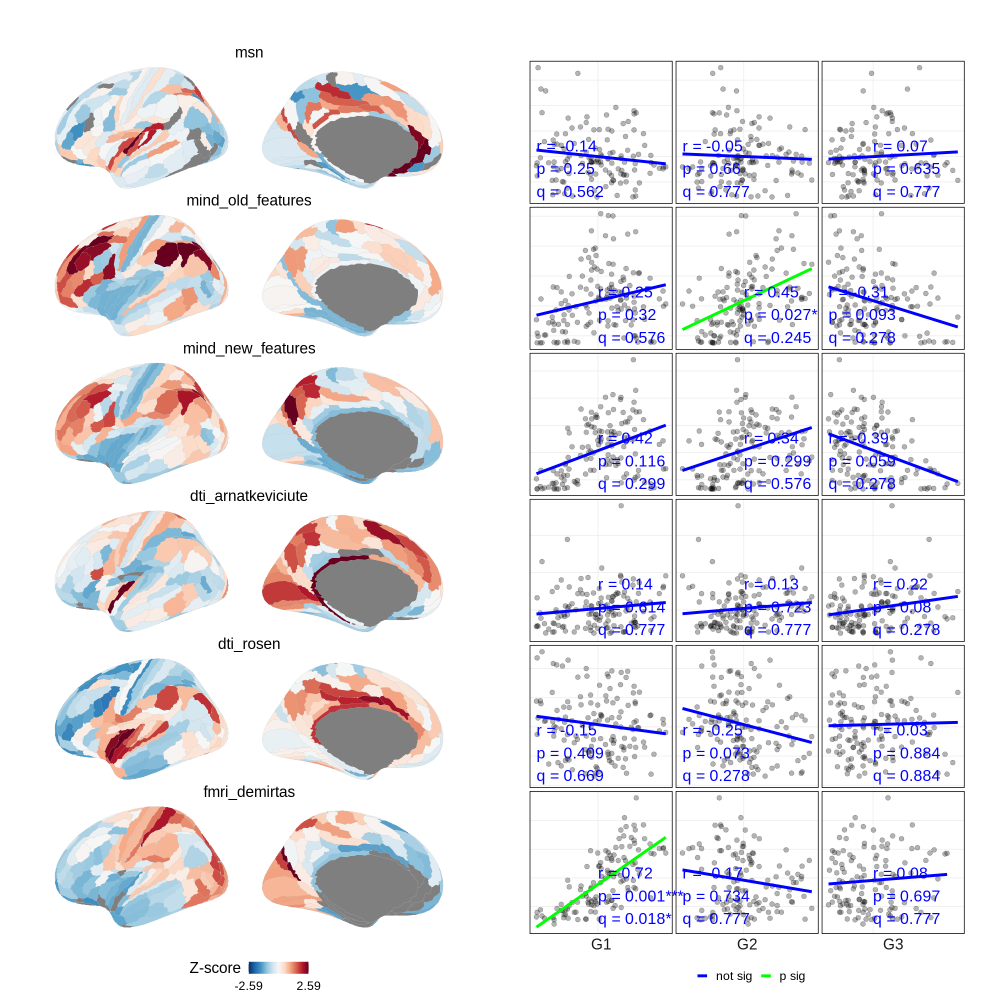

In [2706]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

In [2721]:
net = networks_bin_10['mind_old_features']
distances = hcp_tract_lengths

d_i = (net * distances).sum(0) / net.sum(0)
w_i = np.exp(-beta * d_i)
D_i = (net * distances).sum(0)
rTAPL = w_i * D_i

pearsonr(rTAPL[:180], AG)

PearsonRResult(statistic=array([0.5442395182644016], dtype=object), pvalue=2.8703905089954535e-15)

In [2718]:
pearsonr(axon_length['mind_old_features'], AG)

PearsonRResult(statistic=array([0.5442395182644018], dtype=object), pvalue=2.870390508995372e-15)

In [2774]:
rTAPL_maps = {
    'Average distance of all edges': distances.mean(0),
    '<d> = Average distance of top 10% of edges': d_i,
    'W = Exponential decay of average distance of top 10% edges': w_i,
    'D = Total distance of top 10% distances': D_i,
    'W*D = Axon length (rTAPL)': rTAPL
}

rTAPL_maps = (pd.DataFrame({name:pd.Series(map) for name, map in rTAPL_maps.items()})
              .set_axis(get_labels_hcp())
              .iloc[:180,:]
)
rTAPL_maps

,Average distance of all edges,<d> = Average distance of top 10% of edges,W = Exponential decay of average distance of top 10% edges,D = Total distance of top 10% distances,W*D = Axon length (rTAPL)
label,,,,,
V1,188.847474,136.101725,0.016856,2449.831043,41.294223
MST,182.578726,201.383058,0.002378,402.766115,0.957781
V6,181.211505,141.317215,0.014415,3391.613170,48.888612
V2,187.151004,160.658903,0.008069,4819.767086,38.889092
V3,192.925925,180.353928,0.004469,12264.067098,54.806624
...,...,...,...,...,...
STSva,189.519821,192.562577,0.003098,6354.565041,19.688829
TE1m,184.035019,175.911032,0.005106,6860.530239,35.030148
PI,166.244320,219.352276,0.001387,219.352276,0.304255


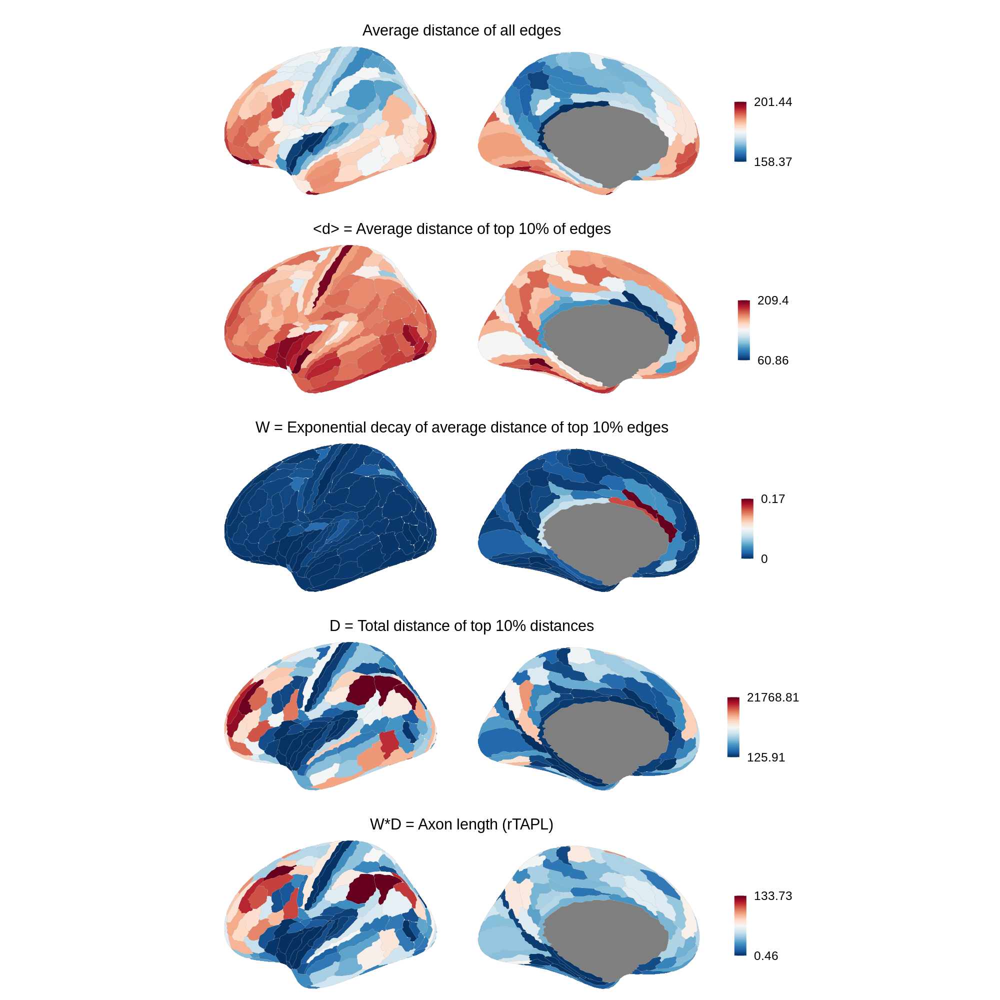

In [2777]:
%%R -i rTAPL_maps -w 20 -h 20 -u in -r 100

plot_one_map <- function(column, data) {
    plot_maps(data %>% select(column), colorscale='absolute', name='') + 
    theme(legend.position='right', plot.margin=margin(0,0,0,0))
}

g <- lapply(colnames(rTAPL_maps), plot_one_map, data=rTAPL_maps)
patchwork::wrap_plots(g, ncol=1)

In [2766]:
df_AG_G2 = {
    'G2': hcp_scores.set_index('label')['G2'],
    # 'AG': get_maps()['glasser_GI'],
    'AG': pd.Series(AG.values.squeeze(), index=get_labels_hcp()[:180]),
    'Axon Length': pd.Series(rTAPL[:180], index=get_labels_hcp()[:180])
}
df_AG_G2 = pd.DataFrame(df_AG_G2).apply(lambda x: (x-np.mean(x))/np.std(x)).reset_index()
df_AG_G2

,label,G2,AG,Axon Length
0,1,0.538109,0.210964,-0.449491
1,10d,NaN,1.157387,0.230268
2,10pp,NaN,0.722067,-0.340702
3,10r,-0.147317,0.321058,-0.024336
4,10v,-0.014065,0.057658,-0.295229
...,...,...,...,...
175,p9-46v,1.124327,1.695719,2.244178
176,pOFC,-0.251623,-0.113774,-0.971012
177,s32,-0.412478,-0.011604,-0.527541
178,s6-8,NaN,2.068164,0.171282


`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


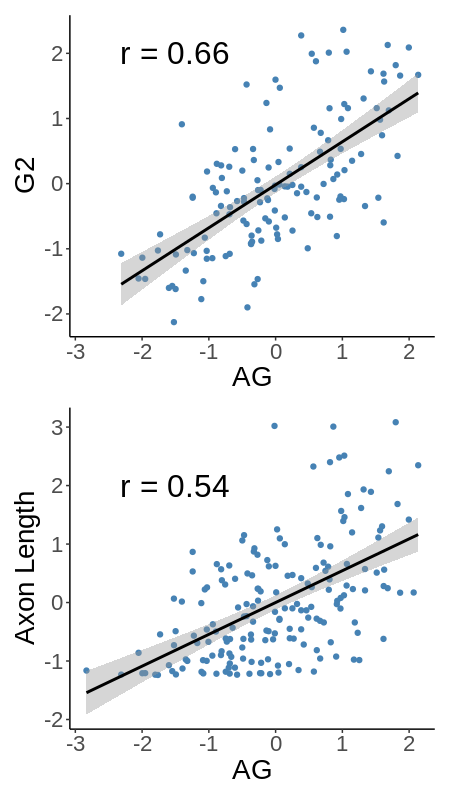

In [2779]:
%%R -i df_AG_G2 -w 4.5 -h 8 -u in -r 100

label1 <- paste0("r = ", round(cor(df_AG_G2$AG,df_AG_G2$G2, 'p'),2))
label2 <- paste0("r = ", round(cor(df_AG_G2$AG,df_AG_G2$`Axon Length`),2))

g1 <- df_AG_G2 %>% 
ggplot(aes(x=AG, y=G2)) + 
geom_point(color='steelblue') +
geom_smooth(method='lm', color='black') +
annotate(geom='text', x=-1.5, y=2, label=label1, size=8) +
theme_classic() + 
theme(text=element_text(size=20))

g2 <- df_AG_G2 %>% 
ggplot(aes(x=AG, y=`Axon Length`)) + 
geom_point(color='steelblue') +
geom_smooth(method='lm', color='black') +
annotate(geom='text', x=-1.5, y=2, label=label2, size=8) +
theme_classic() + 
theme(text=element_text(size=20))

g1 / g2

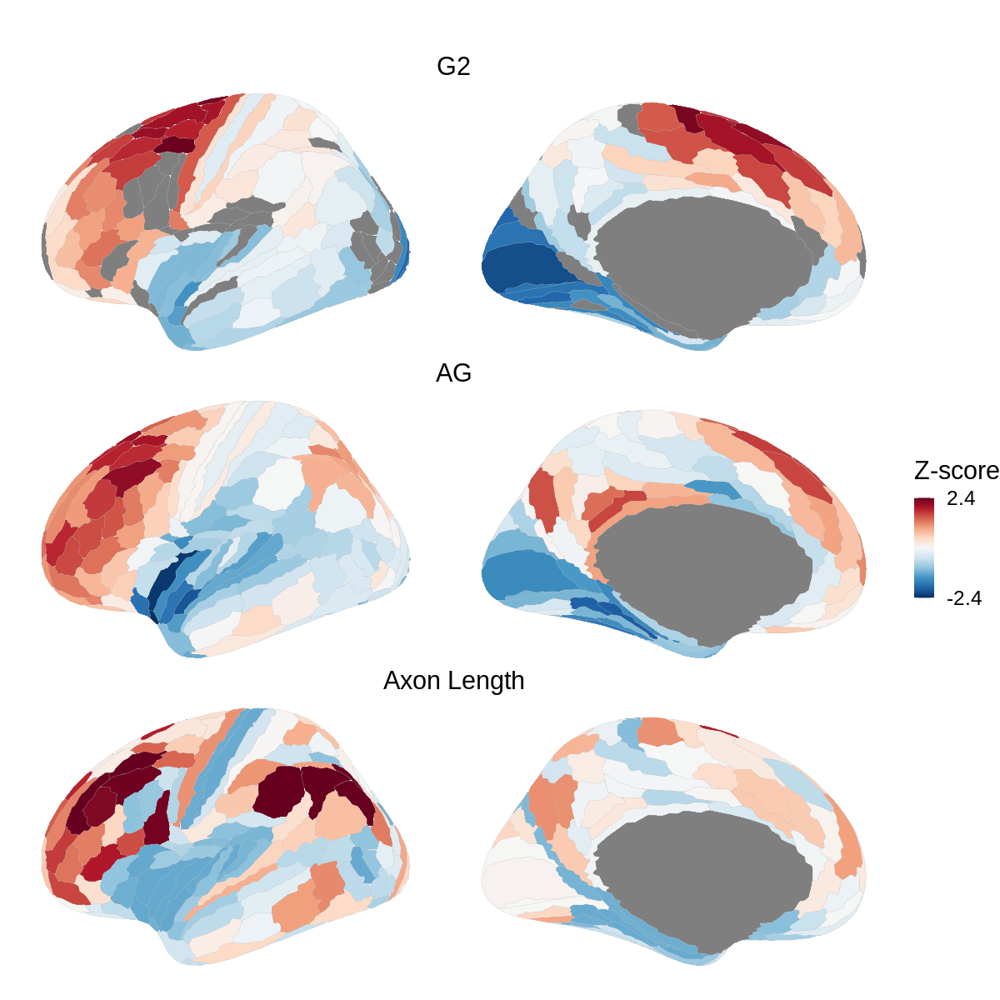

In [2768]:
%%R -i df_AG_G2 -w 12 -h 12 -u in -r 100
plot_maps(df_AG_G2, ncol=1) + theme(legend.position='right')


## Chen model -- grid search best parameters

Surprisingly, the parameters reported in the paper of density 10% and beta 0.03 are near optimal -- but only for MIND_old!

In [2457]:
distances = hcp_tract_lengths
# densities = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
densities = np.arange(0.01, 0.5, 0.02)
# betas = [0.01, 0.02, 0.03, 0.04, 0.05, 0.1, 0.2, 0.3]
betas = np.arange(0.01, 0.3, 0.01)
# densities = [0.1, 0.2]
# betas = [0.03, 0.05]

print(len(densities), len(betas))

25 29


In [2563]:
rAG_density = {}
rG2_density = {}
for density in densities:
    # Threshold networks for given density
    _networks_bin = {name:np.where(net > np.nanquantile(net, 1-density), 1, 0)
                    for name, net in networks.items()}
    
    rAG_beta = {}
    rG2_beta = {}
    for beta in betas:
        # Compute axon lengths with given exponential decay beta
        axon_lengths = {name:pd.Series(get_axon_length(net, distances=distances, beta=beta))
                        for name, net in _networks_bin.items()}
        axon_lengths_df = (pd.DataFrame(axon_lengths)
                            .set_index(get_labels_hcp())
                            .iloc[:180]
                            .apply(lambda x: (x-np.mean(x))/np.std(x))
                            )

        rAG_beta[beta] = pd.concat([AG, axon_lengths_df], axis=1).corr().iloc[:1,1:]
        rG2_beta[beta] = pd.concat([G2, axon_lengths_df], axis=1).corr().iloc[:1,1:]
    
    rAG_density[density] = pd.concat(rAG_beta).droplevel(1)
    rG2_density[density] = pd.concat(rG2_beta).droplevel(1)

df_AG_correlations = pd.concat(rAG_density).rename_axis(['density','beta']).reset_index()
df_G2_correlations = pd.concat(rG2_density).rename_axis(['density','beta']).reset_index()

### Thresholded binary

In [2574]:
pd.concat({
    'Max AG': df_AG_correlations.melt(id_vars=['density','beta']).loc[lambda x: np.argmax(x['value'])],
    'G2 at Max AG': df_G2_correlations.melt(id_vars=['density','beta']).loc[np.argmax(df_AG_correlations.melt(id_vars=['density','beta'])['value'])],
    'Max G2': df_G2_correlations.melt(id_vars=['density','beta']).loc[lambda x: np.argmax(x['value'])],
    'Max AG (mind_old)': df_AG_correlations.melt(id_vars=['density','beta']).query("variable=='mind_old_features'").reset_index(drop=True).loc[lambda x: np.argmax(x['value'])],
    'G2 at Max AG (mind_old)': df_G2_correlations.melt(id_vars=['density','beta']).query("variable=='mind_old_features'").reset_index(drop=True).loc[np.argmax(df_AG_correlations.melt(id_vars=['density','beta']).query("variable=='mind_old_features'")['value'])],
}).unstack(1)

,density,beta,variable,value
Max AG,0.05,0.04,mind_new_features,0.55347
G2 at Max AG,0.05,0.04,mind_new_features,0.339629
Max G2,0.01,0.08,dti_arnatkeviciute,0.554164
Max AG (mind_old),0.11,0.03,mind_old_features,0.549647
G2 at Max AG (mind_old),0.11,0.03,mind_old_features,0.454409


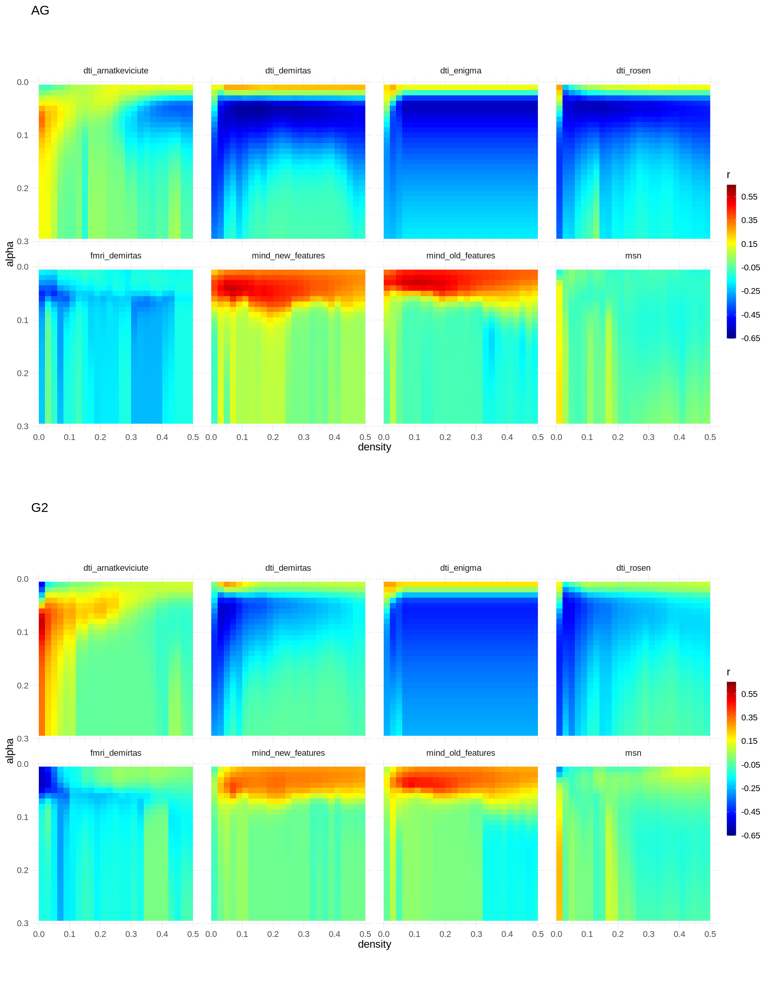

In [2782]:
%%R -i df_AG_correlations -i df_G2_correlations -w 20 -h 26 -u in -r 100
plot_correlation_heatmap <- function(df) {
    df <- df %>% 
    pivot_longer(c(-density,-beta), names_to='map', values_to='r')

    # max_abs = max(abs(df$r))
    max_abs = .65

    df %>% 
    ggplot(aes(x=density, y=beta)) + 
    facet_wrap(~map, ncol=4) +
    geom_raster(aes(fill=r)) + 
    scale_fill_gradientn(colors=jet(100), 
        limits=c(-max_abs, max_abs), breaks=round(seq(-max_abs, max_abs,.2),2)) +
    scale_y_reverse() + ylab('alpha') +
    theme_minimal() + 
    theme(text=element_text(size=20), aspect.ratio=1) +
    guides(fill=guide_colorbar(barheight=20))
}

(plot_correlation_heatmap(df_AG_correlations) + ggtitle('AG')) / 
(plot_correlation_heatmap(df_G2_correlations) + ggtitle('G2'))

### Thresholded weighted

In [2561]:
pd.concat({
    'Max AG': df_AG_correlations.melt(id_vars=['density','beta']).loc[lambda x: np.argmax(x['value'])],
    'G2 at Max AG': df_G2_correlations.melt(id_vars=['density','beta']).loc[np.argmax(df_AG_correlations.melt(id_vars=['density','beta'])['value'])],
    'Max G2': df_G2_correlations.melt(id_vars=['density','beta']).loc[lambda x: np.argmax(x['value'])]
}).unstack(1)

,density,beta,variable,value
Max AG,0.11,0.03,mind_old_features,0.548736
G2 at Max AG,0.11,0.03,mind_old_features,0.438391
Max G2,0.01,0.08,dti_arnatkeviciute,0.545995


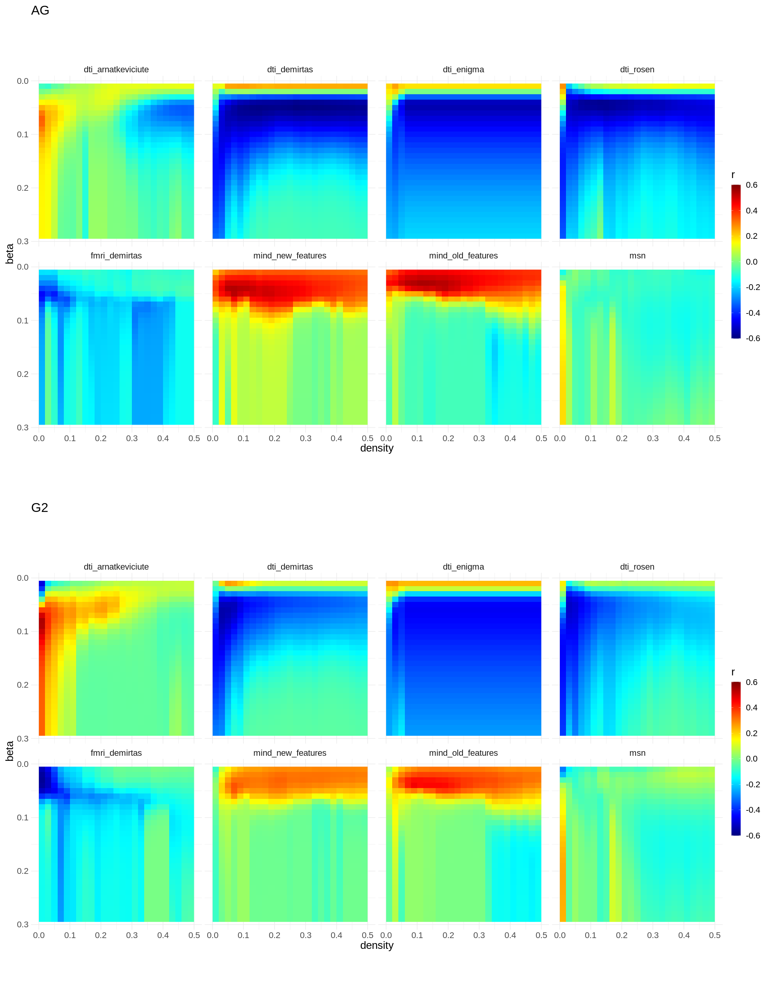

In [2560]:
%%R -i df_AG_correlations -i df_G2_correlations -w 20 -h 26 -u in -r 100
plot_correlation_heatmap <- function(df) {
    df <- df %>% 
    pivot_longer(c(-density,-beta), names_to='map', values_to='r')

    # max_abs = max(abs(df$r))
    max_abs = .6

    df %>% 
    ggplot(aes(x=density, y=beta)) + 
    facet_wrap(~map, ncol=4) +
    geom_raster(aes(fill=r)) + 
    scale_fill_gradientn(colors=jet(100), 
        limits=c(-max_abs, max_abs), breaks=round(seq(-max_abs, max_abs,.2),2)) +
    scale_y_reverse() +
    theme_minimal() + 
    theme(text=element_text(size=20), aspect.ratio=1) +
    guides(fill=guide_colorbar(barheight=20))
}

(plot_correlation_heatmap(df_AG_correlations) + ggtitle('AG')) / 
(plot_correlation_heatmap(df_G2_correlations) + ggtitle('G2'))

In [2562]:
density = .3
A = networks['dti_arnatkeviciute']
B = networks['dti_rosen']

A = np.where(A > np.quantile(A, 1-density), A, 0)
B = np.where(B > np.quantile(B, 1-density), B, 0)

pearsonr(A.flatten(), B.flatten())

PearsonRResult(statistic=0.565439712639907, pvalue=0.0)

In [2314]:
networks_bin_30 = {name:np.where(net > np.nanquantile(net, .70), 1, 0)
                for name, net in networks.items()}

networks_bin_10 = {name:np.where(net > np.nanquantile(net, .90), 1, 0)
                for name, net in networks.items()}

networks_bin_03 = {name:np.where(net > np.nanquantile(net, .97), 1, 0)
                for name, net in networks.items()}

In [2321]:
networks_type_dict = {
    'weighted': networks, 
    'binary_30': networks_bin_30,
    'binary_10': networks_bin_10,
    'binary_03': networks_bin_03
}

distances = hcp_tract_lengths

for name, networks_type in networks_type_dict.items():
    networks_type_dict[name] = (pd.DataFrame({name:pd.Series(get_axon_length(net, distances=distances))
                                for name, net in networks_type.items()})
                                .set_index(get_labels_hcp())
                                .iloc[:180]
                                .apply(lambda x: (x-np.mean(x))/np.std(x))
                                )

maps = pd.concat(networks_type_dict, axis=1)
maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))
maps.head()

/tmp/ipykernel_55371/1004014139.py:2: RuntimeWarning: invalid value encountered in true_divide
  d_i = (net * distances).sum(0) / net.sum(0)
/tmp/ipykernel_55371/1004014139.py:2: RuntimeWarning: invalid value encountered in true_divide
  d_i = (net * distances).sum(0) / net.sum(0)
/tmp/ipykernel_55371/1004014139.py:2: RuntimeWarning: invalid value encountered in true_divide
  d_i = (net * distances).sum(0) / net.sum(0)


,weighted-msn,weighted-mind_old_features,weighted-mind_new_features,weighted-dti_arnatkeviciute,weighted-dti_rosen,weighted-fmri_demirtas,binary_30-msn,binary_30-mind_old_features,binary_30-mind_new_features,binary_30-dti_arnatkeviciute,...,binary_10-mind_new_features,binary_10-dti_arnatkeviciute,binary_10-dti_rosen,binary_10-fmri_demirtas,binary_03-msn,binary_03-mind_old_features,binary_03-mind_new_features,binary_03-dti_arnatkeviciute,binary_03-dti_rosen,binary_03-fmri_demirtas
label,,,,,,,,,,,,,,,,,,,,,
V1,-1.156500,-0.788583,-0.913475,-0.266241,-0.623685,0.504354,-1.516871,-0.744995,-0.866935,0.154040,...,-0.591866,1.830034,-0.188002,0.867772,0.058829,0.908171,0.250820,1.806851,-0.150068,1.439488
MST,-0.272087,-0.636067,-0.424663,-0.212902,-0.425881,0.609838,0.294523,-0.702602,-0.357576,-0.244476,...,-1.083755,-1.288672,-0.513627,0.662708,-0.220813,NaN,NaN,NaN,0.456298,0.483429
V6,0.089739,-0.044086,0.079522,0.193584,-0.206952,1.145122,0.355887,-0.221829,0.466050,0.567445,...,0.595899,0.898956,-0.569982,1.773439,-0.546870,-0.628244,0.326644,1.171006,-0.579180,1.204650
V2,-1.063196,-0.564466,-0.505113,-0.171874,-0.500024,0.969659,-1.553347,-0.494329,-0.185123,0.074090,...,-0.601085,1.269250,0.104773,1.055658,0.243503,0.683702,0.499061,1.651817,0.333437,1.708462
V3,-1.336799,-0.631983,-0.560251,-0.618993,-0.912461,0.686440,-1.606546,-0.052900,0.180537,-0.168127,...,0.430686,1.192784,0.258065,1.022252,0.105822,1.236376,-0.005611,1.204987,0.710290,2.279545


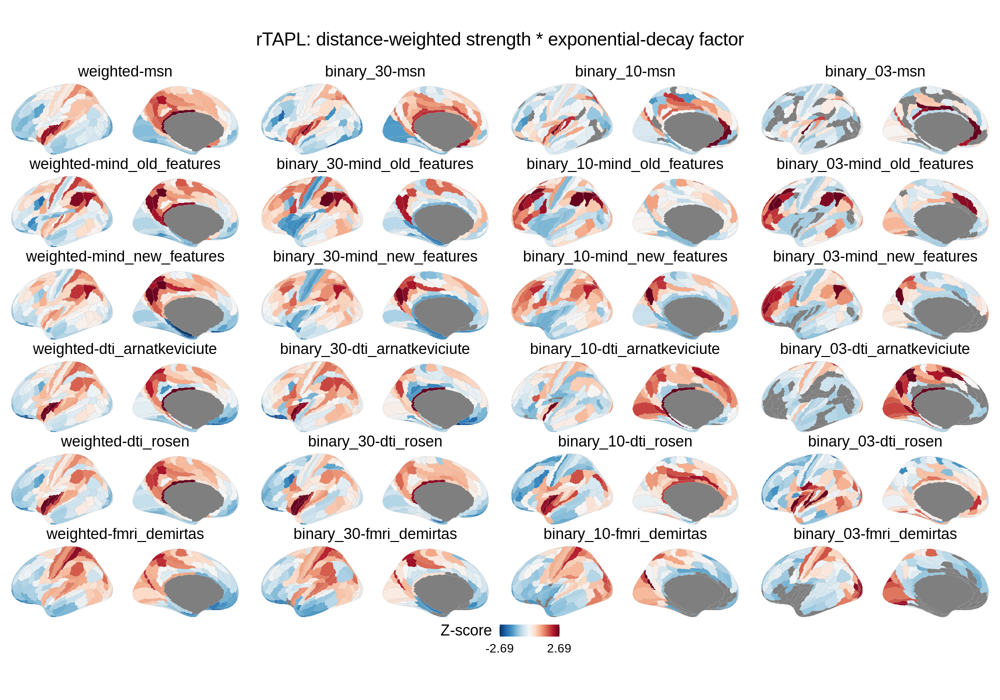

In [2322]:
%%R -i maps -w 20 -h 14 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=4) + theme(plot.title=element_text(vjust=5))

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=3) + 
    xlab('node strength z-score') + ylab('') +
    geom_histogram() + theme_classic()

g1 + ggtitle('rTAPL: distance-weighted strength * exponential-decay factor')

# ((g1 | g2) + plot_layout(widths=c(2,1))) & 
# theme(text=element_text(size=20))

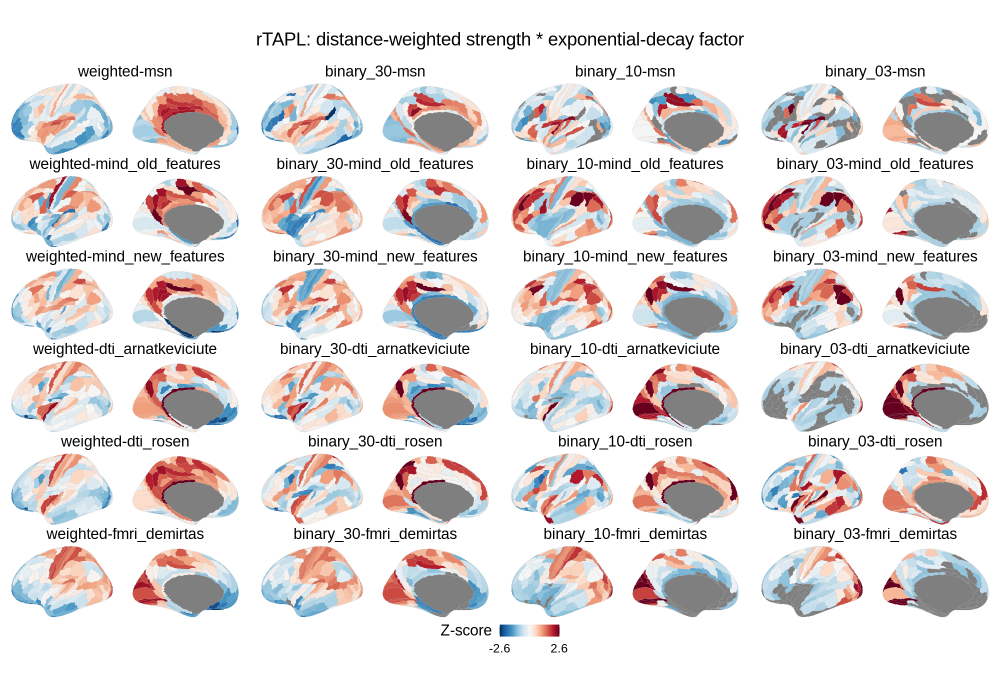

In [ ]:
%%R -i maps -w 20 -h 14 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=4) + theme(plot.title=element_text(vjust=5))

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=3) + 
    xlab('node strength z-score') + ylab('') +
    geom_histogram() + theme_classic()

g1 + ggtitle('rTAPL: distance-weighted strength * exponential-decay factor')

# ((g1 | g2) + plot_layout(widths=c(2,1))) & 
# theme(text=element_text(size=20))

In [2323]:
AG = get_maps()[['glasser_GI']]
df = pd.concat([AG,maps],axis=1).corr().iloc[1:,:1]
df.index = pd.MultiIndex.from_tuples(df.index.str.split('-').tolist())
df.unstack(0)

glasser_GI                              
                    binary_03 binary_10 binary_30  weighted
dti_arnatkeviciute   0.101765  0.096424  0.025282 -0.114930
dti_rosen           -0.474620 -0.430661 -0.354377 -0.195477
fmri_demirtas       -0.305311 -0.189422 -0.173520 -0.102099
mind_new_features    0.454444  0.499093  0.396038  0.151887
mind_old_features    0.465488  0.544240  0.414101  0.114901
msn                 -0.014958 -0.074762 -0.084021 -0.124138

In [ ]:
AG = get_maps()[['glasser_GI']]
df = pd.concat([AG,maps],axis=1).corr().iloc[1:,:1]
df.index = pd.MultiIndex.from_tuples(df.index.str.split('-').tolist())
df.unstack(0)

glasser_GI                              
                    binary_03 binary_10 binary_30  weighted
dti_arnatkeviciute  -0.003879  0.072260  0.131377  0.043878
dti_rosen           -0.349151 -0.002167  0.104348 -0.094050
fmri_demirtas       -0.208702 -0.146398 -0.202831 -0.169287
mind_new_features    0.303112  0.356365  0.290386  0.130597
mind_old_features    0.400295  0.478254  0.366644  0.143078
msn                 -0.061886 -0.115468 -0.220726 -0.261858

In [2279]:
G2 = hcp_scores.set_index('label')[['G2']]
df = pd.concat([G2,maps],axis=1).corr().iloc[1:,:1]
df.index = pd.MultiIndex.from_tuples(df.index.str.split('-').tolist())
df.unstack(0)

G2                              
                   binary_03 binary_10 binary_30  weighted
dti_arnatkeviciute -0.111274  0.029066  0.133432  0.105126
dti_rosen          -0.261539  0.067169  0.102738  0.087971
fmri_demirtas      -0.481457 -0.194767  0.001965 -0.059398
mind_new_features   0.089902  0.240156  0.251712  0.233258
mind_old_features   0.178485  0.334242  0.295588  0.246812
msn                -0.177858 -0.131048 -0.080486 -0.038862

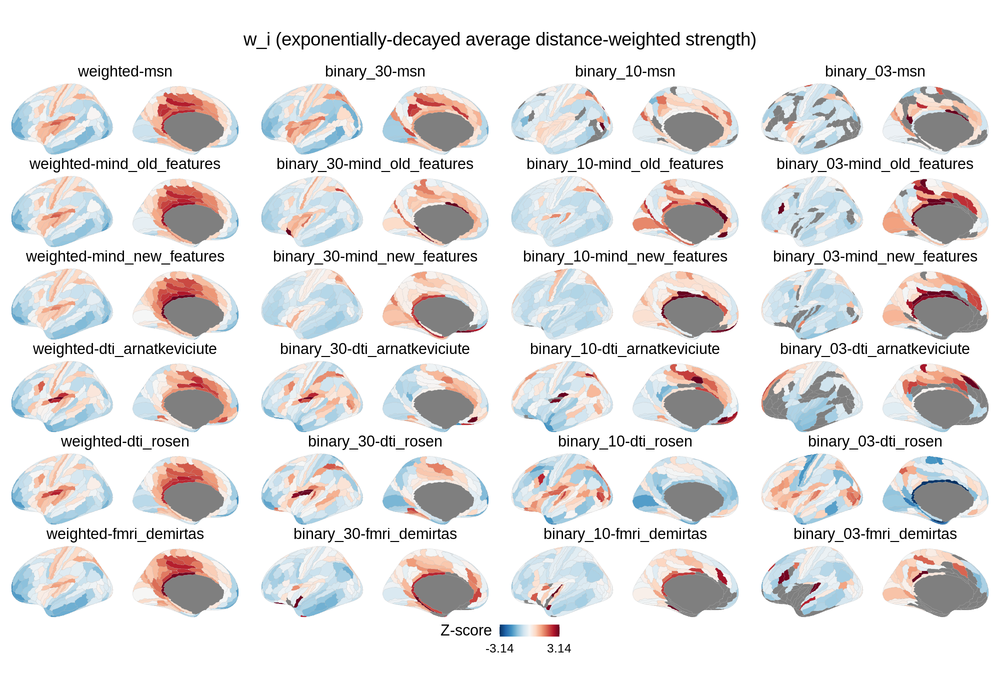

In [ ]:
%%R -i maps -w 20 -h 14 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=4) + theme(plot.title=element_text(vjust=5))

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=3) + 
    xlab('node strength z-score') + ylab('') +
    geom_histogram() + theme_classic()

g1 + ggtitle('w_i (exponentially-decayed average distance-weighted strength)')

# ((g1 | g2) + plot_layout(widths=c(2,1))) & 
# theme(text=element_text(size=20))

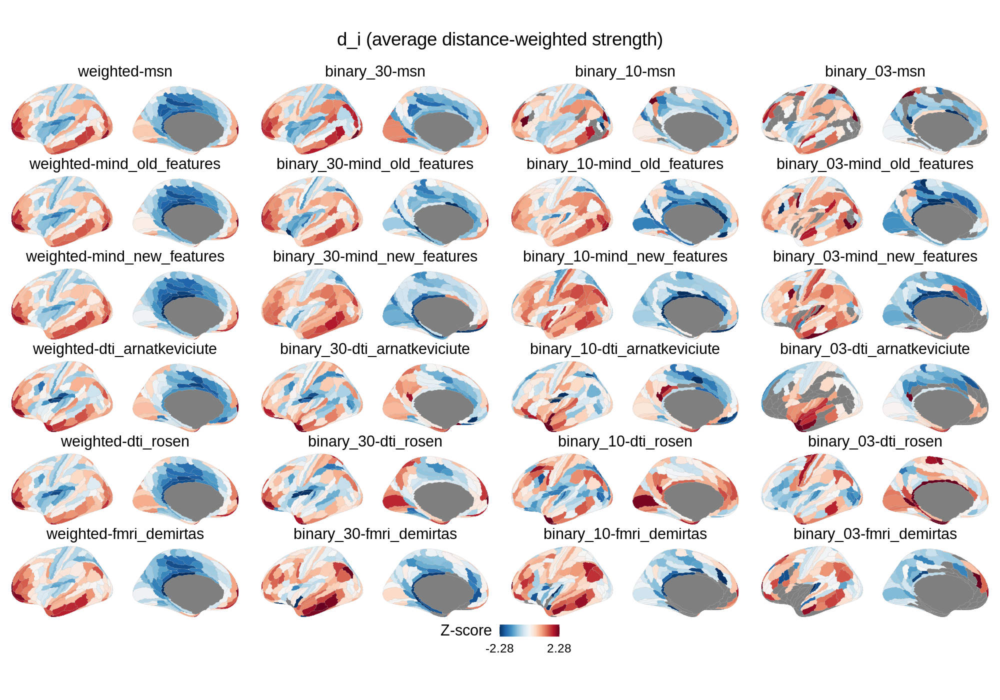

In [ ]:
%%R -i maps -w 20 -h 14 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=4) + theme(plot.title=element_text(vjust=5))

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=3) + 
    xlab('node strength z-score') + ylab('') +
    geom_histogram() + theme_classic()

g1 + ggtitle('d_i (average distance-weighted strength)')

# ((g1 | g2) + plot_layout(widths=c(2,1))) & 
# theme(text=element_text(size=20))

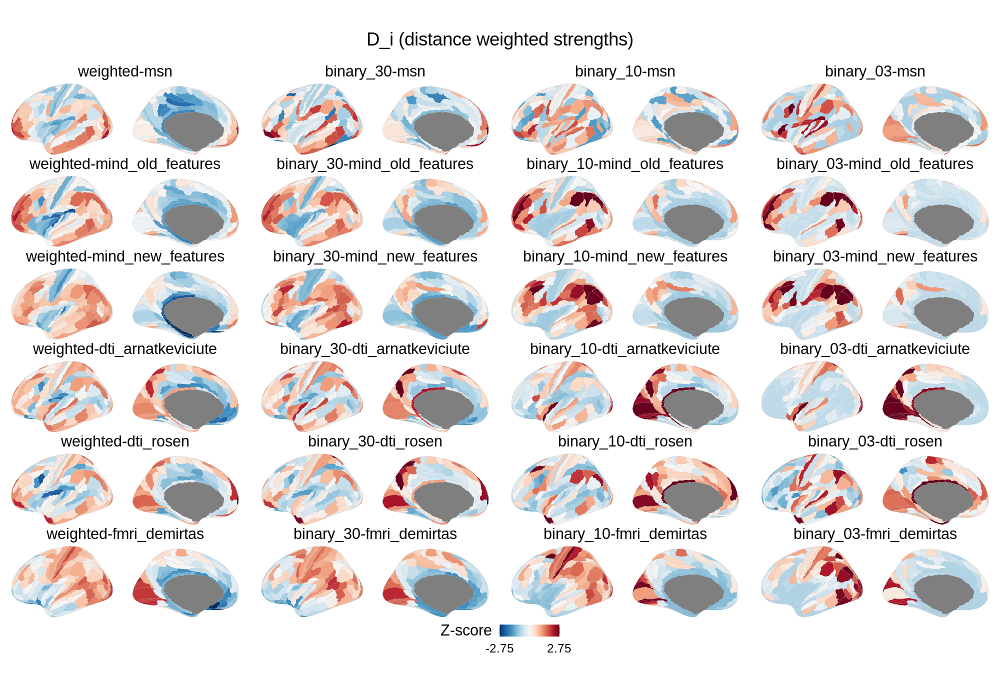

In [ ]:
%%R -i maps -w 20 -h 14 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=4) + theme(plot.title=element_text(vjust=5))

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=3) + 
    xlab('node strength z-score') + ylab('') +
    geom_histogram() + theme_classic()

g1 + ggtitle('D_i (distance weighted strengths)')

# ((g1 | g2) + plot_layout(widths=c(2,1))) & 
# theme(text=element_text(size=20))

In [2145]:
d_i = (net * hcp_euclidean).sum(0) / net.sum(0)

beta = 0.03
w_i = np.exp(-beta * d_i)
w_i[:10]

array([0.12204473, 0.24081548, 0.15238452, 0.11775532, 0.11351595,
       0.12310502, 0.1865811 , 0.15333028, 0.15969779, 0.16209702])

In [2172]:
# rTAPL = w_i * 1 
# rTAPL = w_i * (net * hcp_euclidean).sum(0)
rTAPL = d_i
rTAPL[:10]

array([70.11225415, 47.45747668, 62.7116073 , 71.30487818, 72.52706406,
       69.82391483, 55.9629757 , 62.50536559, 61.14906903, 60.65200767])

In [2173]:
test_maps = get_maps()[['glasser_GI']].assign(axon_length = rTAPL[:180]).apply(lambda x: (x-np.mean(x))/np.std(x))

            glasser_GI axon_length
glasser_GI   1.0000000   0.1438284
axon_length  0.1438284   1.0000000


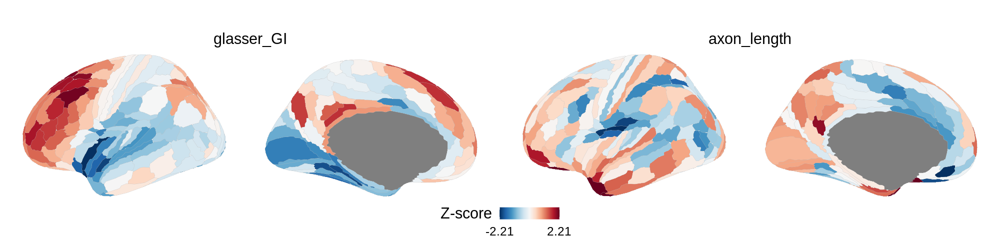

In [2174]:
%%R -i test_maps -w 20 -h 5 -u in -r 100
print(test_maps %>% cor(use='p'))
plot_maps(test_maps, ncol=2)

## PCs / DME of MIND

In [1760]:
net = networks['mind_new_features']

In [1795]:
from sklearn.decomposition import PCA
mind_pca = PCA(n_components=3).fit(net)

from brainspace.gradient import GradientMaps
mind_dme = GradientMaps(n_components=3, approach='dm', kernel='normalized_angle').fit(net, sparsity=0)

In [1796]:
mind_dme_scores = pd.DataFrame(mind_dme.gradients_, index=get_labels_hcp()[:180])

mind_pca_scores = pd.DataFrame(mind_pca.transform(net), index=get_labels_hcp()[:180])
mind_pca_scores

,0,1,2
label,,,
V1,0.501849,0.316548,0.243844
MST,0.117991,0.188420,-0.037816
V6,0.150637,0.417742,0.233978
V2,0.369806,0.407037,0.235928
V3,0.145866,0.538800,0.225220
...,...,...,...
STSva,-0.157329,-0.183876,-0.132231
TE1m,-0.078833,-0.330615,-0.037164
PI,0.272194,-0.189930,-0.036684


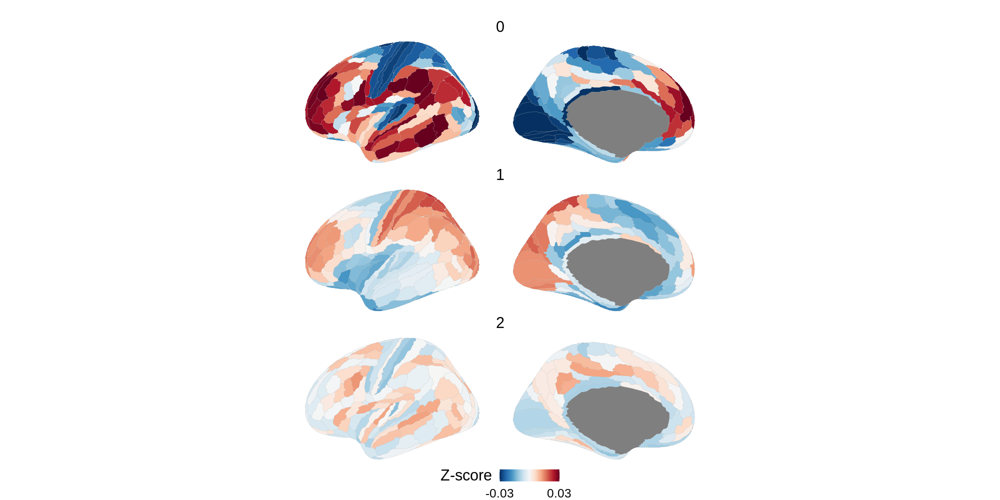

In [1797]:
%%R -i mind_dme_scores -w 20 -h 10 -u in -r 100
plot_maps(mind_dme_scores, ncol=1)

## Rosen tract length

In [2287]:
dti_lengths = mat73.loadmat("../data/averageConnectivity_tractLengths.mat")['tractLengths']

In [2298]:
tract_length_weighted = (dti_lengths * networks_bin_30['dti_rosen']).mean(0)

In [2299]:
(AG
 .assign(tract_length_weighted = pd.Series(tract_length_weighted, index=get_labels_hcp())[:180])
 .assign(G2 = G2)
).corr()

,glasser_GI,tract_length_weighted,G2
glasser_GI,1.000000,0.223353,0.658727
tract_length_weighted,0.223353,1.000000,0.076926
G2,0.658727,0.076926,1.000000
